# Step 1: Data Preparation

The raw images have already been processed and saved in the `processed_data` folder. To see the preprocessing, check out `data_processing.ipynb`

We will load the processed images in memory and normalize them to 0 to 1 instead of 0 - 255

In [1]:
import os
from PIL import Image
import numpy as np

#Constants

INPUT_DIR = "data/"
OUTPUT_DIR = "processed_data/"
os.makedirs(OUTPUT_DIR, exist_ok=True)

# Image Size
TARGET_SIZE = (128, 128)

#Noise vector size
LATENT_DIMS = 100

In [2]:
def load_and_normalize_images(output_dir):
    images = []
    for filename in os.listdir(output_dir):
        file_path = os.path.join(output_dir, filename)
        if os.path.isfile(file_path) and filename.lower().endswith(('.png', '.jpg', '.jpeg')):
            img = Image.open(file_path)
            # Convert image to a NumPy array and normalize to [0, 1]
            img_array = np.array(img) / 255.0
            images.append(img_array)
            
    return np.array(images)


images = load_and_normalize_images(OUTPUT_DIR)
print(f"Processed {len(images)} images.")


Processed 150 images.


# Step 2: Model Training

Now that the data is ready, we need to train the models. Eventually, we will only save the generator because the discriminator is only helpful for training

In [3]:
%pip install -q tensorflow


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: python -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


## Step 2.1: The Discriminator

The Discriminator is a binary classification CNN which will evaluate the generator's output. 

In [4]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, LeakyReLU, BatchNormalization, Flatten, Dense, MaxPooling2D

def build_discriminator(image_size=128, num_channels=3):
    model = Sequential()

    # Input: (image_size, image_size, num_channels)
    model.add(Conv2D(32, kernel_size=(4,4), strides=2,
                     input_shape=(image_size, image_size, num_channels)))
    model.add(MaxPooling2D((2, 2)))
    
    # 2nd Convolutional Layer
    model.add(Conv2D(16, kernel_size=(4,4), strides=2))
    model.add(MaxPooling2D((2, 2)))
    model.add(BatchNormalization())

    #Fully connected
    model.add(Flatten())
    model.add(Dense(32, activation=LeakyReLU(alpha=0.2)))
    # Output layer
    model.add(Dense(1, activation="sigmoid"))  # Output a single probability

    return model

2024-11-27 03:49:55.846242: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-27 03:49:55.849401: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-11-27 03:49:55.858001: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1732679395.872288   98323 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1732679395.876635   98323 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-27 03:49:55.893577: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU ins

In [5]:
discriminator = build_discriminator()
discriminator.summary()

/usr/local/python/3.12.1/lib/python3.12/site-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
2024-11-27 03:49:58.845353: E external/local_xla/xla/stream_executor/cuda/cuda_driver.cc:152] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)
/usr/local/python/3.12.1/lib/python3.12/site-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 63, 63, 32)     │         1,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 31, 31, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 14, 14, 16)     │         8,208 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 7, 7, 16)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 7, 7, 16)       │            64 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 784)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 32)             │        25,120 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 1)              │            33 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 34,993 (136.69 KB)

 Trainable params: 34,961 (136.57 KB)

 Non-trainable params: 32 (128.00 B)

## Step 2.2: The Generator

The Generator will take in random noise and produce the image. Instead of `Conv2D` layers (like in the Discriminator), we will use `Conv2DTranspose` layers

In [6]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Reshape, Conv2DTranspose, BatchNormalization, LeakyReLU

def build_generator(latent_dim=LATENT_DIMS, num_channels=3):
    model = Sequential()

    # Fully connected layer to reshape latent vector into a smaller feature map
    model.add(Dense(8 * 8 * 64, input_dim=latent_dim))  # Smaller feature map
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((8, 8, 64)))  # Output shape: (8, 8, 64)

    # First upsampling layer
    model.add(Conv2DTranspose(64, kernel_size=4, strides=2, padding="same"))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())

    # Second upsampling layer
    model.add(Conv2DTranspose(32, kernel_size=4, strides=2, padding="same"))
    model.add(LeakyReLU(alpha=0.2))
    model.add(BatchNormalization())

    # Output layer
    model.add(Conv2DTranspose(num_channels, kernel_size=4, strides=4, padding="same", activation="tanh"))

    return model

In [7]:
generator = build_generator()
generator.summary()

/usr/local/python/3.12.1/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_2 (Dense)                 │ (None, 4096)           │       413,696 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 4096)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape (Reshape)               │ (None, 8, 8, 64)       │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 16, 16, 64)     │        65,600 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 16, 16, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 16, 16, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 32, 32, 32)     │        32,800 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 32, 32, 32)     │           128 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 128, 128, 3)    │         1,539 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 514,019 (1.96 MB)

 Trainable params: 513,827 (1.96 MB)

 Non-trainable params: 192 (768.00 B)

## Step 2.3: Training

Since we do not have features and labels per se, we cannot just call `model.fit()`. Instead, we need to define our own training loop

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
import matplotlib.pyplot as plt


class GAN:
    def __init__(self, generator, discriminator, batch_size=32, latent_dims=100):
        self.generator = generator
        self.discriminator = discriminator
        self.BATCH_SIZE = batch_size       
        self.LATENT_DIMS =  latent_dims

        self.discriminator.trainable = False
        self.gan = tf.keras.models.Sequential([self.generator, self.discriminator])

        discriminator_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)
        generator_optimizer = Adam(learning_rate=0.0002, beta_1=0.5)
        
        self.gan.compile(
            loss='binary_crossentropy',
            optimizer=generator_optimizer,
        )

        self.discriminator.trainable = True        
        self.discriminator.compile(
            loss='binary_crossentropy',
            optimizer=discriminator_optimizer,
            metrics=['accuracy']
        )
        
        print(self.discriminator._loss_tracker)


    def get_images(self, num_images):
        noise = np.random.normal(0, 1, (num_images, self.LATENT_DIMS))
        images = self.generator.predict(noise, verbose=0)
        return images

    def train_discriminator(self, data):
        self.discriminator.trainable = True
        idx = np.random.randint(0, data.shape[0], self.BATCH_SIZE)
        real_images = data[idx]

        # Generate fake images
        fake_images = self.get_images(self.BATCH_SIZE)
        #Labels
        real_labels = np.ones((self.BATCH_SIZE, 1))
        fake_labels = np.zeros((self.BATCH_SIZE, 1))
        
        # Train the discriminator
        d_loss_real = self.discriminator.train_on_batch(real_images, real_labels)
        d_loss_fake = self.discriminator.train_on_batch(fake_images, fake_labels)
        d_loss = np.add(d_loss_real, d_loss_fake)
        
        self.discriminator.trainable = False
        return d_loss
    

    def train_generator(self):
        self.generator.trainable = True
        noise = np.random.normal(0, 1, (self.BATCH_SIZE, self.LATENT_DIMS))
        labels = np.ones((self.BATCH_SIZE, 1)) #All ones so that the fake (0) reflects as loss
        
        g_loss = self.gan.train_on_batch(noise, labels)

        self.generator.trainable = False
        return g_loss
    

    def show_generated_image(self, noise):
        fake_image = self.generator.predict(noise, verbose=0)[0]
        assert(self.generator.weights == self.gan.layers[0].weights)
        fake_image = np.clip(fake_image * 255, 0, 255).astype(np.uint8)  # Denormalize
        plt.imshow(fake_image)
        plt.axis('off')
        plt.show()
        

    def train(self, data, epochs):
        FIXED_LOSS = np.random.normal(0, 1, (1, self.LATENT_DIMS))
        for i in range(epochs):
            disc_loss = self.train_discriminator(data)
            gan_loss = self.train_generator()
            print(f"Epoch {i} completed\n\n")

            if i%100 == 0: #Shows results every 100 epochs
                print(f"Discriminator Loss: {disc_loss}")
                print(f"Generator Loss: {gan_loss}")
                self.show_generated_image(FIXED_LOSS)

    

In [13]:
gan = GAN(generator, discriminator)

<Mean name=loss>


Epoch 0 completed


Discriminator Loss: [0.00446152 2.        ]
Generator Loss: 0.003563186153769493


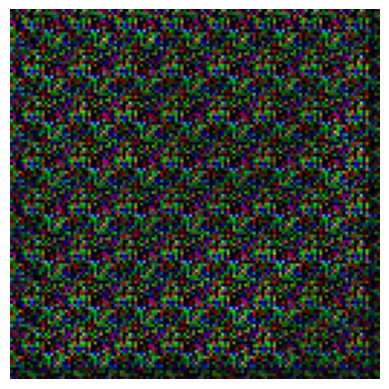

Epoch 1 completed


Epoch 2 completed


Epoch 3 completed


Epoch 4 completed


Epoch 5 completed


Epoch 6 completed


Epoch 7 completed


Epoch 8 completed


Epoch 9 completed


Epoch 10 completed


Epoch 11 completed


Epoch 12 completed


Epoch 13 completed


Epoch 14 completed


Epoch 15 completed


Epoch 16 completed


Epoch 17 completed


Epoch 18 completed


Epoch 19 completed


Epoch 20 completed


Epoch 21 completed


Epoch 22 completed


Epoch 23 completed


Epoch 24 completed


Epoch 25 completed


Epoch 26 completed


Epoch 27 completed


Epoch 28 completed


Epoch 29 completed


Epoch 30 completed


Epoch 31 completed


Epoch 32 completed


Epoch 33 completed


Epoch 34 completed


Epoch 35 completed


Epoch 36 completed


Epoch 37 completed


Epoch 38 completed


Epoch 39 completed


Epoch 40 completed


Epoch 41 completed


Epoch 42 completed


Epoch 43 completed


Epoch 44 completed


Epoch 45 completed


Epoch 46 completed


Epoch 47 completed


Epoch 48 completed


E

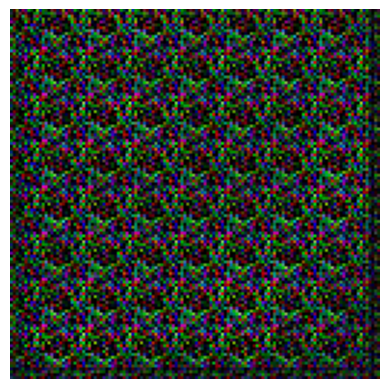

Epoch 101 completed


Epoch 102 completed


Epoch 103 completed


Epoch 104 completed


Epoch 105 completed


Epoch 106 completed


Epoch 107 completed


Epoch 108 completed


Epoch 109 completed


Epoch 110 completed


Epoch 111 completed


Epoch 112 completed


Epoch 113 completed


Epoch 114 completed


Epoch 115 completed


Epoch 116 completed


Epoch 117 completed


Epoch 118 completed


Epoch 119 completed


Epoch 120 completed


Epoch 121 completed


Epoch 122 completed


Epoch 123 completed


Epoch 124 completed


Epoch 125 completed


Epoch 126 completed


Epoch 127 completed


Epoch 128 completed


Epoch 129 completed


Epoch 130 completed


Epoch 131 completed


Epoch 132 completed


Epoch 133 completed


Epoch 134 completed


Epoch 135 completed


Epoch 136 completed


Epoch 137 completed


Epoch 138 completed


Epoch 139 completed


Epoch 140 completed


Epoch 141 completed


Epoch 142 completed


Epoch 143 completed


Epoch 144 completed


Epoch 145 completed


Epoch 146 

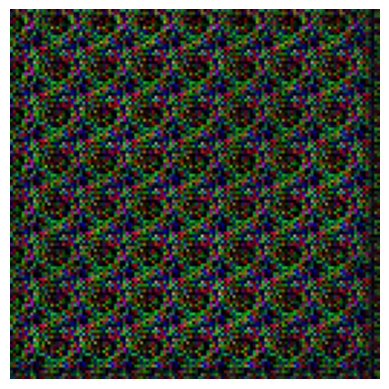

Epoch 201 completed


Epoch 202 completed


Epoch 203 completed


Epoch 204 completed


Epoch 205 completed


Epoch 206 completed


Epoch 207 completed


Epoch 208 completed


Epoch 209 completed


Epoch 210 completed


Epoch 211 completed


Epoch 212 completed


Epoch 213 completed


Epoch 214 completed


Epoch 215 completed


Epoch 216 completed


Epoch 217 completed


Epoch 218 completed


Epoch 219 completed


Epoch 220 completed


Epoch 221 completed


Epoch 222 completed


Epoch 223 completed


Epoch 224 completed


Epoch 225 completed


Epoch 226 completed


Epoch 227 completed


Epoch 228 completed


Epoch 229 completed


Epoch 230 completed


Epoch 231 completed


Epoch 232 completed


Epoch 233 completed


Epoch 234 completed


Epoch 235 completed


Epoch 236 completed


Epoch 237 completed


Epoch 238 completed


Epoch 239 completed


Epoch 240 completed


Epoch 241 completed


Epoch 242 completed


Epoch 243 completed


Epoch 244 completed


Epoch 245 completed


Epoch 246 

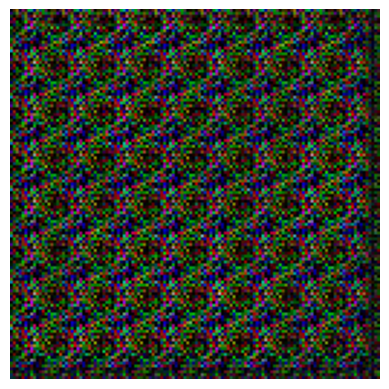

Epoch 301 completed


Epoch 302 completed


Epoch 303 completed


Epoch 304 completed


Epoch 305 completed


Epoch 306 completed


Epoch 307 completed


Epoch 308 completed


Epoch 309 completed


Epoch 310 completed


Epoch 311 completed


Epoch 312 completed


Epoch 313 completed


Epoch 314 completed


Epoch 315 completed


Epoch 316 completed


Epoch 317 completed


Epoch 318 completed


Epoch 319 completed


Epoch 320 completed


Epoch 321 completed


Epoch 322 completed


Epoch 323 completed


Epoch 324 completed


Epoch 325 completed


Epoch 326 completed


Epoch 327 completed


Epoch 328 completed


Epoch 329 completed


Epoch 330 completed


Epoch 331 completed


Epoch 332 completed


Epoch 333 completed


Epoch 334 completed


Epoch 335 completed


Epoch 336 completed


Epoch 337 completed


Epoch 338 completed


Epoch 339 completed


Epoch 340 completed


Epoch 341 completed


Epoch 342 completed


Epoch 343 completed


Epoch 344 completed


Epoch 345 completed


Epoch 346 

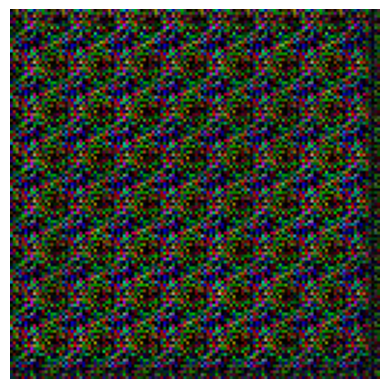

Epoch 401 completed


Epoch 402 completed


Epoch 403 completed


Epoch 404 completed


Epoch 405 completed


Epoch 406 completed


Epoch 407 completed


Epoch 408 completed


Epoch 409 completed


Epoch 410 completed


Epoch 411 completed


Epoch 412 completed


Epoch 413 completed


Epoch 414 completed


Epoch 415 completed


Epoch 416 completed


Epoch 417 completed


Epoch 418 completed


Epoch 419 completed


Epoch 420 completed


Epoch 421 completed


Epoch 422 completed


Epoch 423 completed


Epoch 424 completed


Epoch 425 completed


Epoch 426 completed


Epoch 427 completed


Epoch 428 completed


Epoch 429 completed


Epoch 430 completed


Epoch 431 completed


Epoch 432 completed


Epoch 433 completed


Epoch 434 completed


Epoch 435 completed


Epoch 436 completed


Epoch 437 completed


Epoch 438 completed


Epoch 439 completed


Epoch 440 completed


Epoch 441 completed


Epoch 442 completed


Epoch 443 completed


Epoch 444 completed


Epoch 445 completed


Epoch 446 

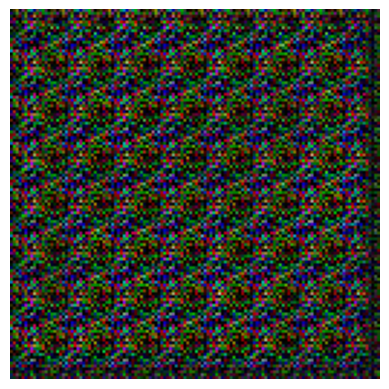

Epoch 501 completed


Epoch 502 completed


Epoch 503 completed


Epoch 504 completed


Epoch 505 completed


Epoch 506 completed


Epoch 507 completed


Epoch 508 completed


Epoch 509 completed


Epoch 510 completed


Epoch 511 completed


Epoch 512 completed


Epoch 513 completed


Epoch 514 completed


Epoch 515 completed


Epoch 516 completed


Epoch 517 completed


Epoch 518 completed


Epoch 519 completed


Epoch 520 completed


Epoch 521 completed


Epoch 522 completed


Epoch 523 completed


Epoch 524 completed


Epoch 525 completed


Epoch 526 completed


Epoch 527 completed


Epoch 528 completed


Epoch 529 completed


Epoch 530 completed


Epoch 531 completed


Epoch 532 completed


Epoch 533 completed


Epoch 534 completed


Epoch 535 completed


Epoch 536 completed


Epoch 537 completed


Epoch 538 completed


Epoch 539 completed


Epoch 540 completed


Epoch 541 completed


Epoch 542 completed


Epoch 543 completed


Epoch 544 completed


Epoch 545 completed


Epoch 546 

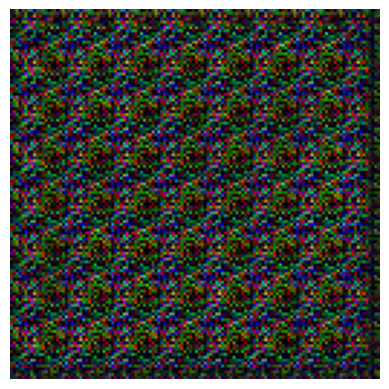

Epoch 601 completed


Epoch 602 completed


Epoch 603 completed


Epoch 604 completed


Epoch 605 completed


Epoch 606 completed


Epoch 607 completed


Epoch 608 completed


Epoch 609 completed


Epoch 610 completed


Epoch 611 completed


Epoch 612 completed


Epoch 613 completed


Epoch 614 completed


Epoch 615 completed


Epoch 616 completed


Epoch 617 completed


Epoch 618 completed


Epoch 619 completed


Epoch 620 completed


Epoch 621 completed


Epoch 622 completed


Epoch 623 completed


Epoch 624 completed


Epoch 625 completed


Epoch 626 completed


Epoch 627 completed


Epoch 628 completed


Epoch 629 completed


Epoch 630 completed


Epoch 631 completed


Epoch 632 completed


Epoch 633 completed


Epoch 634 completed


Epoch 635 completed


Epoch 636 completed


Epoch 637 completed


Epoch 638 completed


Epoch 639 completed


Epoch 640 completed


Epoch 641 completed


Epoch 642 completed


Epoch 643 completed


Epoch 644 completed


Epoch 645 completed


Epoch 646 

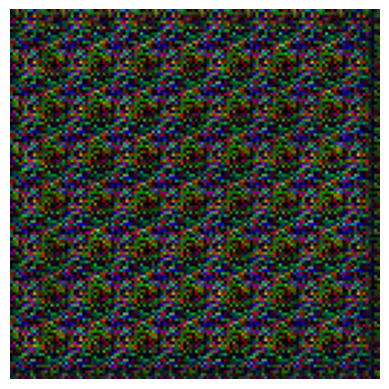

Epoch 701 completed


Epoch 702 completed


Epoch 703 completed


Epoch 704 completed


Epoch 705 completed


Epoch 706 completed


Epoch 707 completed


Epoch 708 completed


Epoch 709 completed


Epoch 710 completed


Epoch 711 completed


Epoch 712 completed


Epoch 713 completed


Epoch 714 completed


Epoch 715 completed


Epoch 716 completed


Epoch 717 completed


Epoch 718 completed


Epoch 719 completed


Epoch 720 completed


Epoch 721 completed


Epoch 722 completed


Epoch 723 completed


Epoch 724 completed


Epoch 725 completed


Epoch 726 completed


Epoch 727 completed


Epoch 728 completed


Epoch 729 completed


Epoch 730 completed


Epoch 731 completed


Epoch 732 completed


Epoch 733 completed


Epoch 734 completed


Epoch 735 completed


Epoch 736 completed


Epoch 737 completed


Epoch 738 completed


Epoch 739 completed


Epoch 740 completed


Epoch 741 completed


Epoch 742 completed


Epoch 743 completed


Epoch 744 completed


Epoch 745 completed


Epoch 746 

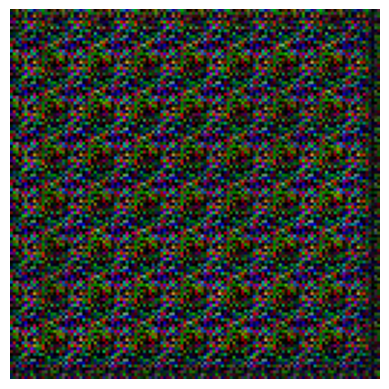

Epoch 801 completed


Epoch 802 completed


Epoch 803 completed


Epoch 804 completed


Epoch 805 completed


Epoch 806 completed


Epoch 807 completed


Epoch 808 completed


Epoch 809 completed


Epoch 810 completed


Epoch 811 completed


Epoch 812 completed


Epoch 813 completed


Epoch 814 completed


Epoch 815 completed


Epoch 816 completed


Epoch 817 completed


Epoch 818 completed


Epoch 819 completed


Epoch 820 completed


Epoch 821 completed


Epoch 822 completed


Epoch 823 completed


Epoch 824 completed


Epoch 825 completed


Epoch 826 completed


Epoch 827 completed


Epoch 828 completed


Epoch 829 completed


Epoch 830 completed


Epoch 831 completed


Epoch 832 completed


Epoch 833 completed


Epoch 834 completed


Epoch 835 completed


Epoch 836 completed


Epoch 837 completed


Epoch 838 completed


Epoch 839 completed


Epoch 840 completed


Epoch 841 completed


Epoch 842 completed


Epoch 843 completed


Epoch 844 completed


Epoch 845 completed


Epoch 846 

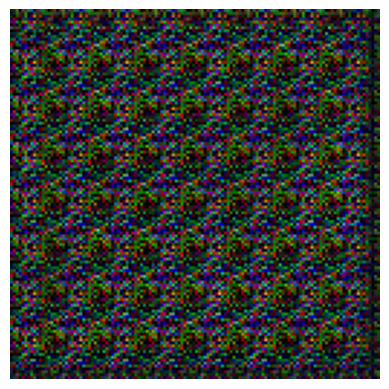

Epoch 901 completed


Epoch 902 completed


Epoch 903 completed


Epoch 904 completed


Epoch 905 completed


Epoch 906 completed


Epoch 907 completed


Epoch 908 completed


Epoch 909 completed


Epoch 910 completed


Epoch 911 completed


Epoch 912 completed


Epoch 913 completed


Epoch 914 completed


Epoch 915 completed


Epoch 916 completed


Epoch 917 completed


Epoch 918 completed


Epoch 919 completed


Epoch 920 completed


Epoch 921 completed


Epoch 922 completed


Epoch 923 completed


Epoch 924 completed


Epoch 925 completed


Epoch 926 completed


Epoch 927 completed


Epoch 928 completed


Epoch 929 completed


Epoch 930 completed


Epoch 931 completed


Epoch 932 completed


Epoch 933 completed


Epoch 934 completed


Epoch 935 completed


Epoch 936 completed


Epoch 937 completed


Epoch 938 completed


Epoch 939 completed


Epoch 940 completed


Epoch 941 completed


Epoch 942 completed


Epoch 943 completed


Epoch 944 completed


Epoch 945 completed


Epoch 946 

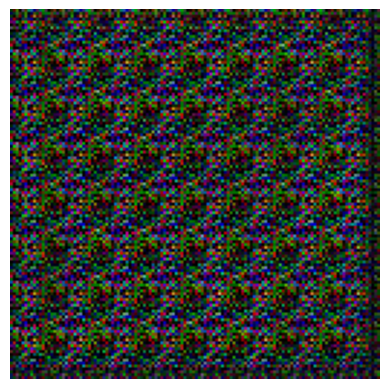

Epoch 1001 completed


Epoch 1002 completed


Epoch 1003 completed


Epoch 1004 completed


Epoch 1005 completed


Epoch 1006 completed


Epoch 1007 completed


Epoch 1008 completed


Epoch 1009 completed


Epoch 1010 completed


Epoch 1011 completed


Epoch 1012 completed


Epoch 1013 completed


Epoch 1014 completed


Epoch 1015 completed


Epoch 1016 completed


Epoch 1017 completed


Epoch 1018 completed


Epoch 1019 completed


Epoch 1020 completed


Epoch 1021 completed


Epoch 1022 completed


Epoch 1023 completed


Epoch 1024 completed


Epoch 1025 completed


Epoch 1026 completed


Epoch 1027 completed


Epoch 1028 completed


Epoch 1029 completed


Epoch 1030 completed


Epoch 1031 completed


Epoch 1032 completed


Epoch 1033 completed


Epoch 1034 completed


Epoch 1035 completed


Epoch 1036 completed


Epoch 1037 completed


Epoch 1038 completed


Epoch 1039 completed


Epoch 1040 completed


Epoch 1041 completed


Epoch 1042 completed


Epoch 1043 completed


Epoch 1044 

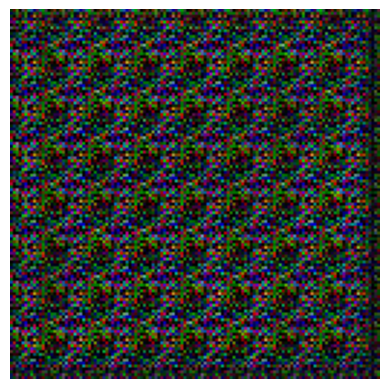

Epoch 1101 completed


Epoch 1102 completed


Epoch 1103 completed


Epoch 1104 completed


Epoch 1105 completed


Epoch 1106 completed


Epoch 1107 completed


Epoch 1108 completed


Epoch 1109 completed


Epoch 1110 completed


Epoch 1111 completed


Epoch 1112 completed


Epoch 1113 completed


Epoch 1114 completed


Epoch 1115 completed


Epoch 1116 completed


Epoch 1117 completed


Epoch 1118 completed


Epoch 1119 completed


Epoch 1120 completed


Epoch 1121 completed


Epoch 1122 completed


Epoch 1123 completed


Epoch 1124 completed


Epoch 1125 completed


Epoch 1126 completed


Epoch 1127 completed


Epoch 1128 completed


Epoch 1129 completed


Epoch 1130 completed


Epoch 1131 completed


Epoch 1132 completed


Epoch 1133 completed


Epoch 1134 completed


Epoch 1135 completed


Epoch 1136 completed


Epoch 1137 completed


Epoch 1138 completed


Epoch 1139 completed


Epoch 1140 completed


Epoch 1141 completed


Epoch 1142 completed


Epoch 1143 completed


Epoch 1144 

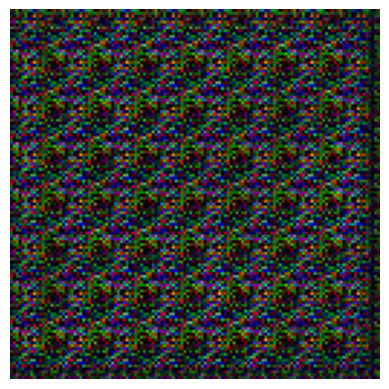

Epoch 1201 completed


Epoch 1202 completed


Epoch 1203 completed


Epoch 1204 completed


Epoch 1205 completed


Epoch 1206 completed


Epoch 1207 completed


Epoch 1208 completed


Epoch 1209 completed


Epoch 1210 completed


Epoch 1211 completed


Epoch 1212 completed


Epoch 1213 completed


Epoch 1214 completed


Epoch 1215 completed


Epoch 1216 completed


Epoch 1217 completed


Epoch 1218 completed


Epoch 1219 completed


Epoch 1220 completed


Epoch 1221 completed


Epoch 1222 completed


Epoch 1223 completed


Epoch 1224 completed


Epoch 1225 completed


Epoch 1226 completed


Epoch 1227 completed


Epoch 1228 completed


Epoch 1229 completed


Epoch 1230 completed


Epoch 1231 completed


Epoch 1232 completed


Epoch 1233 completed


Epoch 1234 completed


Epoch 1235 completed


Epoch 1236 completed


Epoch 1237 completed


Epoch 1238 completed


Epoch 1239 completed


Epoch 1240 completed


Epoch 1241 completed


Epoch 1242 completed


Epoch 1243 completed


Epoch 1244 

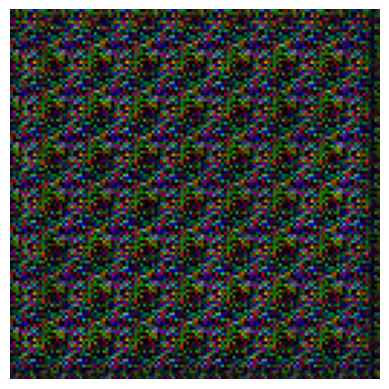

Epoch 1301 completed


Epoch 1302 completed


Epoch 1303 completed


Epoch 1304 completed


Epoch 1305 completed


Epoch 1306 completed


Epoch 1307 completed


Epoch 1308 completed


Epoch 1309 completed


Epoch 1310 completed


Epoch 1311 completed


Epoch 1312 completed


Epoch 1313 completed


Epoch 1314 completed


Epoch 1315 completed


Epoch 1316 completed


Epoch 1317 completed


Epoch 1318 completed


Epoch 1319 completed


Epoch 1320 completed


Epoch 1321 completed


Epoch 1322 completed


Epoch 1323 completed


Epoch 1324 completed


Epoch 1325 completed


Epoch 1326 completed


Epoch 1327 completed


Epoch 1328 completed


Epoch 1329 completed


Epoch 1330 completed


Epoch 1331 completed


Epoch 1332 completed


Epoch 1333 completed


Epoch 1334 completed


Epoch 1335 completed


Epoch 1336 completed


Epoch 1337 completed


Epoch 1338 completed


Epoch 1339 completed


Epoch 1340 completed


Epoch 1341 completed


Epoch 1342 completed


Epoch 1343 completed


Epoch 1344 

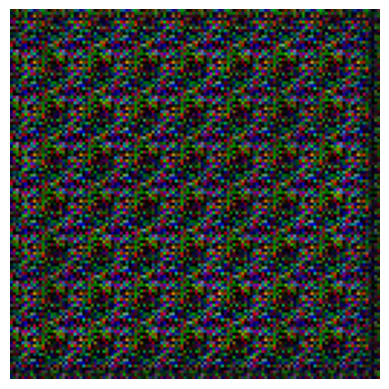

Epoch 1401 completed


Epoch 1402 completed


Epoch 1403 completed


Epoch 1404 completed


Epoch 1405 completed


Epoch 1406 completed


Epoch 1407 completed


Epoch 1408 completed


Epoch 1409 completed


Epoch 1410 completed


Epoch 1411 completed


Epoch 1412 completed


Epoch 1413 completed


Epoch 1414 completed


Epoch 1415 completed


Epoch 1416 completed


Epoch 1417 completed


Epoch 1418 completed


Epoch 1419 completed


Epoch 1420 completed


Epoch 1421 completed


Epoch 1422 completed


Epoch 1423 completed


Epoch 1424 completed


Epoch 1425 completed


Epoch 1426 completed


Epoch 1427 completed


Epoch 1428 completed


Epoch 1429 completed


Epoch 1430 completed


Epoch 1431 completed


Epoch 1432 completed


Epoch 1433 completed


Epoch 1434 completed


Epoch 1435 completed


Epoch 1436 completed


Epoch 1437 completed


Epoch 1438 completed


Epoch 1439 completed


Epoch 1440 completed


Epoch 1441 completed


Epoch 1442 completed


Epoch 1443 completed


Epoch 1444 

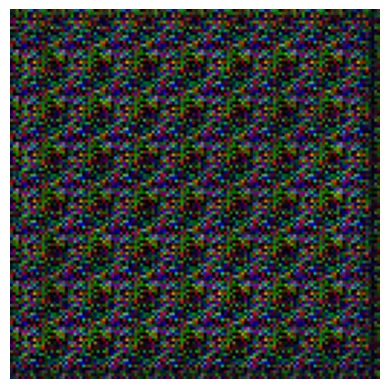

Epoch 1501 completed


Epoch 1502 completed


Epoch 1503 completed


Epoch 1504 completed


Epoch 1505 completed


Epoch 1506 completed


Epoch 1507 completed


Epoch 1508 completed


Epoch 1509 completed


Epoch 1510 completed


Epoch 1511 completed


Epoch 1512 completed


Epoch 1513 completed


Epoch 1514 completed


Epoch 1515 completed


Epoch 1516 completed


Epoch 1517 completed


Epoch 1518 completed


Epoch 1519 completed


Epoch 1520 completed


Epoch 1521 completed


Epoch 1522 completed


Epoch 1523 completed


Epoch 1524 completed


Epoch 1525 completed


Epoch 1526 completed


Epoch 1527 completed


Epoch 1528 completed


Epoch 1529 completed


Epoch 1530 completed


Epoch 1531 completed


Epoch 1532 completed


Epoch 1533 completed


Epoch 1534 completed


Epoch 1535 completed


Epoch 1536 completed


Epoch 1537 completed


Epoch 1538 completed


Epoch 1539 completed


Epoch 1540 completed


Epoch 1541 completed


Epoch 1542 completed


Epoch 1543 completed


Epoch 1544 

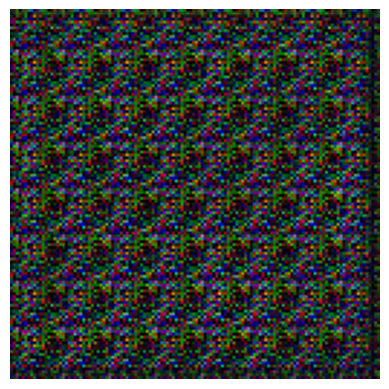

Epoch 1601 completed


Epoch 1602 completed


Epoch 1603 completed


Epoch 1604 completed


Epoch 1605 completed


Epoch 1606 completed


Epoch 1607 completed


Epoch 1608 completed


Epoch 1609 completed


Epoch 1610 completed


Epoch 1611 completed


Epoch 1612 completed


Epoch 1613 completed


Epoch 1614 completed


Epoch 1615 completed


Epoch 1616 completed


Epoch 1617 completed


Epoch 1618 completed


Epoch 1619 completed


Epoch 1620 completed


Epoch 1621 completed


Epoch 1622 completed


Epoch 1623 completed


Epoch 1624 completed


Epoch 1625 completed


Epoch 1626 completed


Epoch 1627 completed


Epoch 1628 completed


Epoch 1629 completed


Epoch 1630 completed


Epoch 1631 completed


Epoch 1632 completed


Epoch 1633 completed


Epoch 1634 completed


Epoch 1635 completed


Epoch 1636 completed


Epoch 1637 completed


Epoch 1638 completed


Epoch 1639 completed


Epoch 1640 completed


Epoch 1641 completed


Epoch 1642 completed


Epoch 1643 completed


Epoch 1644 

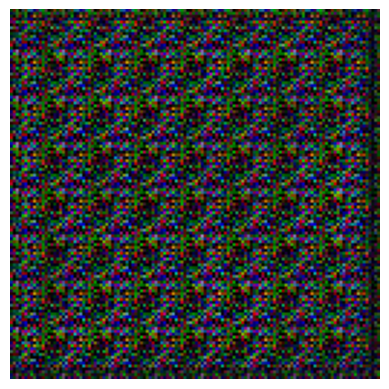

Epoch 1701 completed


Epoch 1702 completed


Epoch 1703 completed


Epoch 1704 completed


Epoch 1705 completed


Epoch 1706 completed


Epoch 1707 completed


Epoch 1708 completed


Epoch 1709 completed


Epoch 1710 completed


Epoch 1711 completed


Epoch 1712 completed


Epoch 1713 completed


Epoch 1714 completed


Epoch 1715 completed


Epoch 1716 completed


Epoch 1717 completed


Epoch 1718 completed


Epoch 1719 completed


Epoch 1720 completed


Epoch 1721 completed


Epoch 1722 completed


Epoch 1723 completed


Epoch 1724 completed


Epoch 1725 completed


Epoch 1726 completed


Epoch 1727 completed


Epoch 1728 completed


Epoch 1729 completed


Epoch 1730 completed


Epoch 1731 completed


Epoch 1732 completed


Epoch 1733 completed


Epoch 1734 completed


Epoch 1735 completed


Epoch 1736 completed


Epoch 1737 completed


Epoch 1738 completed


Epoch 1739 completed


Epoch 1740 completed


Epoch 1741 completed


Epoch 1742 completed


Epoch 1743 completed


Epoch 1744 

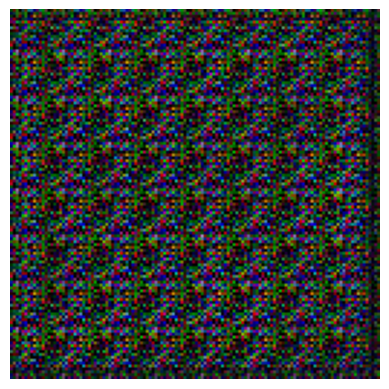

Epoch 1801 completed


Epoch 1802 completed


Epoch 1803 completed


Epoch 1804 completed


Epoch 1805 completed


Epoch 1806 completed


Epoch 1807 completed


Epoch 1808 completed


Epoch 1809 completed


Epoch 1810 completed


Epoch 1811 completed


Epoch 1812 completed


Epoch 1813 completed


Epoch 1814 completed


Epoch 1815 completed


Epoch 1816 completed


Epoch 1817 completed


Epoch 1818 completed


Epoch 1819 completed


Epoch 1820 completed


Epoch 1821 completed


Epoch 1822 completed


Epoch 1823 completed


Epoch 1824 completed


Epoch 1825 completed


Epoch 1826 completed


Epoch 1827 completed


Epoch 1828 completed


Epoch 1829 completed


Epoch 1830 completed


Epoch 1831 completed


Epoch 1832 completed


Epoch 1833 completed


Epoch 1834 completed


Epoch 1835 completed


Epoch 1836 completed


Epoch 1837 completed


Epoch 1838 completed


Epoch 1839 completed


Epoch 1840 completed


Epoch 1841 completed


Epoch 1842 completed


Epoch 1843 completed


Epoch 1844 

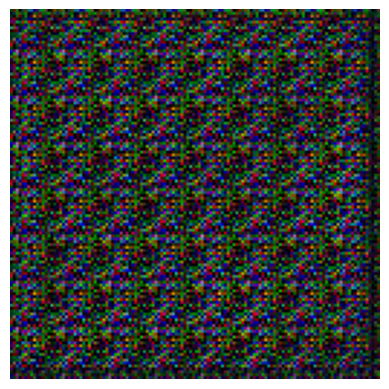

Epoch 1901 completed


Epoch 1902 completed


Epoch 1903 completed


Epoch 1904 completed


Epoch 1905 completed


Epoch 1906 completed


Epoch 1907 completed


Epoch 1908 completed


Epoch 1909 completed


Epoch 1910 completed


Epoch 1911 completed


Epoch 1912 completed


Epoch 1913 completed


Epoch 1914 completed


Epoch 1915 completed


Epoch 1916 completed


Epoch 1917 completed


Epoch 1918 completed


Epoch 1919 completed


Epoch 1920 completed


Epoch 1921 completed


Epoch 1922 completed


Epoch 1923 completed


Epoch 1924 completed


Epoch 1925 completed


Epoch 1926 completed


Epoch 1927 completed


Epoch 1928 completed


Epoch 1929 completed


Epoch 1930 completed


Epoch 1931 completed


Epoch 1932 completed


Epoch 1933 completed


Epoch 1934 completed


Epoch 1935 completed


Epoch 1936 completed


Epoch 1937 completed


Epoch 1938 completed


Epoch 1939 completed


Epoch 1940 completed


Epoch 1941 completed


Epoch 1942 completed


Epoch 1943 completed


Epoch 1944 

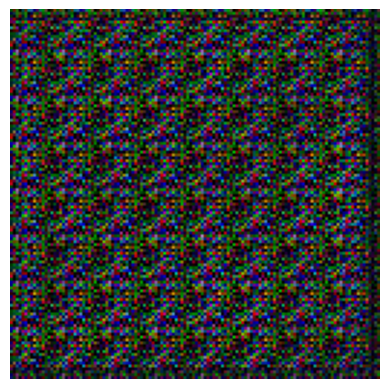

Epoch 2001 completed


Epoch 2002 completed


Epoch 2003 completed


Epoch 2004 completed


Epoch 2005 completed


Epoch 2006 completed


Epoch 2007 completed


Epoch 2008 completed


Epoch 2009 completed


Epoch 2010 completed


Epoch 2011 completed


Epoch 2012 completed


Epoch 2013 completed


Epoch 2014 completed


Epoch 2015 completed


Epoch 2016 completed


Epoch 2017 completed


Epoch 2018 completed


Epoch 2019 completed


Epoch 2020 completed


Epoch 2021 completed


Epoch 2022 completed


Epoch 2023 completed


Epoch 2024 completed


Epoch 2025 completed


Epoch 2026 completed


Epoch 2027 completed


Epoch 2028 completed


Epoch 2029 completed


Epoch 2030 completed


Epoch 2031 completed


Epoch 2032 completed


Epoch 2033 completed


Epoch 2034 completed


Epoch 2035 completed


Epoch 2036 completed


Epoch 2037 completed


Epoch 2038 completed


Epoch 2039 completed


Epoch 2040 completed


Epoch 2041 completed


Epoch 2042 completed


Epoch 2043 completed


Epoch 2044 

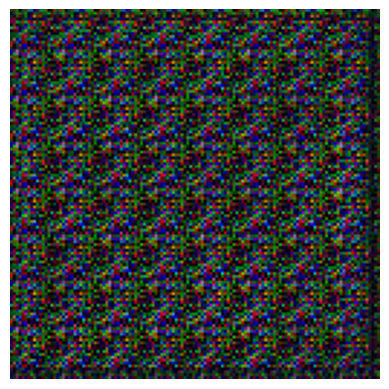

Epoch 2101 completed


Epoch 2102 completed


Epoch 2103 completed


Epoch 2104 completed


Epoch 2105 completed


Epoch 2106 completed


Epoch 2107 completed


Epoch 2108 completed


Epoch 2109 completed


Epoch 2110 completed


Epoch 2111 completed


Epoch 2112 completed


Epoch 2113 completed


Epoch 2114 completed


Epoch 2115 completed


Epoch 2116 completed


Epoch 2117 completed


Epoch 2118 completed


Epoch 2119 completed


Epoch 2120 completed


Epoch 2121 completed


Epoch 2122 completed


Epoch 2123 completed


Epoch 2124 completed


Epoch 2125 completed


Epoch 2126 completed


Epoch 2127 completed


Epoch 2128 completed


Epoch 2129 completed


Epoch 2130 completed


Epoch 2131 completed


Epoch 2132 completed


Epoch 2133 completed


Epoch 2134 completed


Epoch 2135 completed


Epoch 2136 completed


Epoch 2137 completed


Epoch 2138 completed


Epoch 2139 completed


Epoch 2140 completed


Epoch 2141 completed


Epoch 2142 completed


Epoch 2143 completed


Epoch 2144 

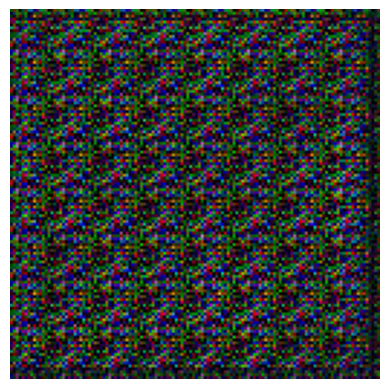

Epoch 2201 completed


Epoch 2202 completed


Epoch 2203 completed


Epoch 2204 completed


Epoch 2205 completed


Epoch 2206 completed


Epoch 2207 completed


Epoch 2208 completed


Epoch 2209 completed


Epoch 2210 completed


Epoch 2211 completed


Epoch 2212 completed


Epoch 2213 completed


Epoch 2214 completed


Epoch 2215 completed


Epoch 2216 completed


Epoch 2217 completed


Epoch 2218 completed


Epoch 2219 completed


Epoch 2220 completed


Epoch 2221 completed


Epoch 2222 completed


Epoch 2223 completed


Epoch 2224 completed


Epoch 2225 completed


Epoch 2226 completed


Epoch 2227 completed


Epoch 2228 completed


Epoch 2229 completed


Epoch 2230 completed


Epoch 2231 completed


Epoch 2232 completed


Epoch 2233 completed


Epoch 2234 completed


Epoch 2235 completed


Epoch 2236 completed


Epoch 2237 completed


Epoch 2238 completed


Epoch 2239 completed


Epoch 2240 completed


Epoch 2241 completed


Epoch 2242 completed


Epoch 2243 completed


Epoch 2244 

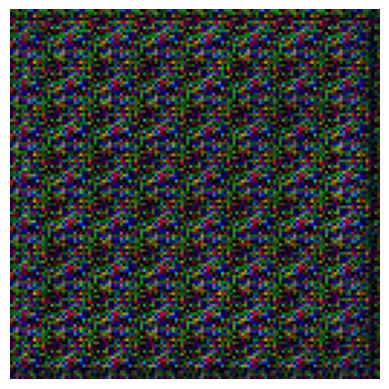

Epoch 2301 completed


Epoch 2302 completed


Epoch 2303 completed


Epoch 2304 completed


Epoch 2305 completed


Epoch 2306 completed


Epoch 2307 completed


Epoch 2308 completed


Epoch 2309 completed


Epoch 2310 completed


Epoch 2311 completed


Epoch 2312 completed


Epoch 2313 completed


Epoch 2314 completed


Epoch 2315 completed


Epoch 2316 completed


Epoch 2317 completed


Epoch 2318 completed


Epoch 2319 completed


Epoch 2320 completed


Epoch 2321 completed


Epoch 2322 completed


Epoch 2323 completed


Epoch 2324 completed


Epoch 2325 completed


Epoch 2326 completed


Epoch 2327 completed


Epoch 2328 completed


Epoch 2329 completed


Epoch 2330 completed


Epoch 2331 completed


Epoch 2332 completed


Epoch 2333 completed


Epoch 2334 completed


Epoch 2335 completed


Epoch 2336 completed


Epoch 2337 completed


Epoch 2338 completed


Epoch 2339 completed


Epoch 2340 completed


Epoch 2341 completed


Epoch 2342 completed


Epoch 2343 completed


Epoch 2344 

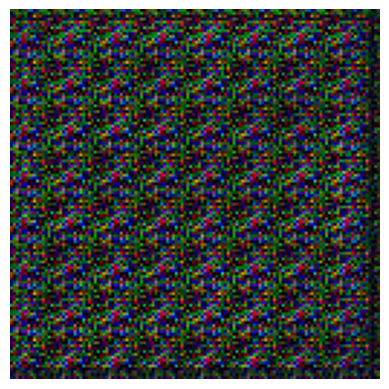

Epoch 2401 completed


Epoch 2402 completed


Epoch 2403 completed


Epoch 2404 completed


Epoch 2405 completed


Epoch 2406 completed


Epoch 2407 completed


Epoch 2408 completed


Epoch 2409 completed


Epoch 2410 completed


Epoch 2411 completed


Epoch 2412 completed


Epoch 2413 completed


Epoch 2414 completed


Epoch 2415 completed


Epoch 2416 completed


Epoch 2417 completed


Epoch 2418 completed


Epoch 2419 completed


Epoch 2420 completed


Epoch 2421 completed


Epoch 2422 completed


Epoch 2423 completed


Epoch 2424 completed


Epoch 2425 completed


Epoch 2426 completed


Epoch 2427 completed


Epoch 2428 completed


Epoch 2429 completed


Epoch 2430 completed


Epoch 2431 completed


Epoch 2432 completed


Epoch 2433 completed


Epoch 2434 completed


Epoch 2435 completed


Epoch 2436 completed


Epoch 2437 completed


Epoch 2438 completed


Epoch 2439 completed


Epoch 2440 completed


Epoch 2441 completed


Epoch 2442 completed


Epoch 2443 completed


Epoch 2444 

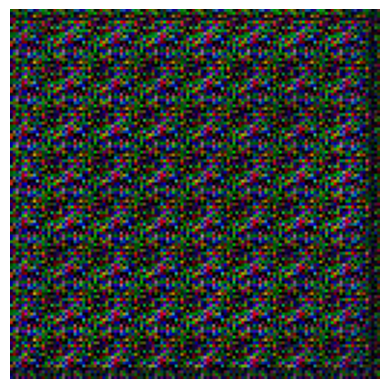

Epoch 2501 completed


Epoch 2502 completed


Epoch 2503 completed


Epoch 2504 completed


Epoch 2505 completed


Epoch 2506 completed


Epoch 2507 completed


Epoch 2508 completed


Epoch 2509 completed


Epoch 2510 completed


Epoch 2511 completed


Epoch 2512 completed


Epoch 2513 completed


Epoch 2514 completed


Epoch 2515 completed


Epoch 2516 completed


Epoch 2517 completed


Epoch 2518 completed


Epoch 2519 completed


Epoch 2520 completed


Epoch 2521 completed


Epoch 2522 completed


Epoch 2523 completed


Epoch 2524 completed


Epoch 2525 completed


Epoch 2526 completed


Epoch 2527 completed


Epoch 2528 completed


Epoch 2529 completed


Epoch 2530 completed


Epoch 2531 completed


Epoch 2532 completed


Epoch 2533 completed


Epoch 2534 completed


Epoch 2535 completed


Epoch 2536 completed


Epoch 2537 completed


Epoch 2538 completed


Epoch 2539 completed


Epoch 2540 completed


Epoch 2541 completed


Epoch 2542 completed


Epoch 2543 completed


Epoch 2544 

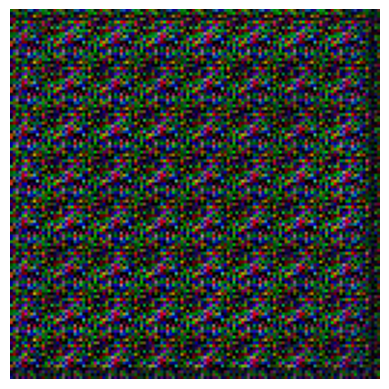

Epoch 2601 completed


Epoch 2602 completed


Epoch 2603 completed


Epoch 2604 completed


Epoch 2605 completed


Epoch 2606 completed


Epoch 2607 completed


Epoch 2608 completed


Epoch 2609 completed


Epoch 2610 completed


Epoch 2611 completed


Epoch 2612 completed


Epoch 2613 completed


Epoch 2614 completed


Epoch 2615 completed


Epoch 2616 completed


Epoch 2617 completed


Epoch 2618 completed


Epoch 2619 completed


Epoch 2620 completed


Epoch 2621 completed


Epoch 2622 completed


Epoch 2623 completed


Epoch 2624 completed


Epoch 2625 completed


Epoch 2626 completed


Epoch 2627 completed


Epoch 2628 completed


Epoch 2629 completed


Epoch 2630 completed


Epoch 2631 completed


Epoch 2632 completed


Epoch 2633 completed


Epoch 2634 completed


Epoch 2635 completed


Epoch 2636 completed


Epoch 2637 completed


Epoch 2638 completed


Epoch 2639 completed


Epoch 2640 completed


Epoch 2641 completed


Epoch 2642 completed


Epoch 2643 completed


Epoch 2644 

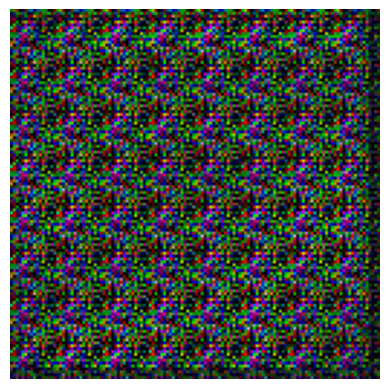

Epoch 2701 completed


Epoch 2702 completed


Epoch 2703 completed


Epoch 2704 completed


Epoch 2705 completed


Epoch 2706 completed


Epoch 2707 completed


Epoch 2708 completed


Epoch 2709 completed


Epoch 2710 completed


Epoch 2711 completed


Epoch 2712 completed


Epoch 2713 completed


Epoch 2714 completed


Epoch 2715 completed


Epoch 2716 completed


Epoch 2717 completed


Epoch 2718 completed


Epoch 2719 completed


Epoch 2720 completed


Epoch 2721 completed


Epoch 2722 completed


Epoch 2723 completed


Epoch 2724 completed


Epoch 2725 completed


Epoch 2726 completed


Epoch 2727 completed


Epoch 2728 completed


Epoch 2729 completed


Epoch 2730 completed


Epoch 2731 completed


Epoch 2732 completed


Epoch 2733 completed


Epoch 2734 completed


Epoch 2735 completed


Epoch 2736 completed


Epoch 2737 completed


Epoch 2738 completed


Epoch 2739 completed


Epoch 2740 completed


Epoch 2741 completed


Epoch 2742 completed


Epoch 2743 completed


Epoch 2744 

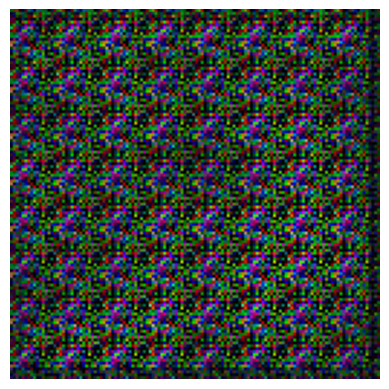

Epoch 2801 completed


Epoch 2802 completed


Epoch 2803 completed


Epoch 2804 completed


Epoch 2805 completed


Epoch 2806 completed


Epoch 2807 completed


Epoch 2808 completed


Epoch 2809 completed


Epoch 2810 completed


Epoch 2811 completed


Epoch 2812 completed


Epoch 2813 completed


Epoch 2814 completed


Epoch 2815 completed


Epoch 2816 completed


Epoch 2817 completed


Epoch 2818 completed


Epoch 2819 completed


Epoch 2820 completed


Epoch 2821 completed


Epoch 2822 completed


Epoch 2823 completed


Epoch 2824 completed


Epoch 2825 completed


Epoch 2826 completed


Epoch 2827 completed


Epoch 2828 completed


Epoch 2829 completed


Epoch 2830 completed


Epoch 2831 completed


Epoch 2832 completed


Epoch 2833 completed


Epoch 2834 completed


Epoch 2835 completed


Epoch 2836 completed


Epoch 2837 completed


Epoch 2838 completed


Epoch 2839 completed


Epoch 2840 completed


Epoch 2841 completed


Epoch 2842 completed


Epoch 2843 completed


Epoch 2844 

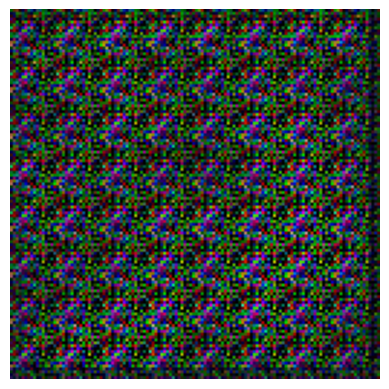

Epoch 2901 completed


Epoch 2902 completed


Epoch 2903 completed


Epoch 2904 completed


Epoch 2905 completed


Epoch 2906 completed


Epoch 2907 completed


Epoch 2908 completed


Epoch 2909 completed


Epoch 2910 completed


Epoch 2911 completed


Epoch 2912 completed


Epoch 2913 completed


Epoch 2914 completed


Epoch 2915 completed


Epoch 2916 completed


Epoch 2917 completed


Epoch 2918 completed


Epoch 2919 completed


Epoch 2920 completed


Epoch 2921 completed


Epoch 2922 completed


Epoch 2923 completed


Epoch 2924 completed


Epoch 2925 completed


Epoch 2926 completed


Epoch 2927 completed


Epoch 2928 completed


Epoch 2929 completed


Epoch 2930 completed


Epoch 2931 completed


Epoch 2932 completed


Epoch 2933 completed


Epoch 2934 completed


Epoch 2935 completed


Epoch 2936 completed


Epoch 2937 completed


Epoch 2938 completed


Epoch 2939 completed


Epoch 2940 completed


Epoch 2941 completed


Epoch 2942 completed


Epoch 2943 completed


Epoch 2944 

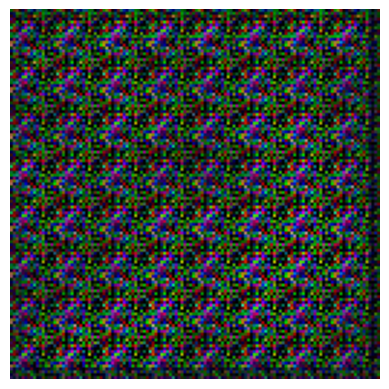

Epoch 3001 completed


Epoch 3002 completed


Epoch 3003 completed


Epoch 3004 completed


Epoch 3005 completed


Epoch 3006 completed


Epoch 3007 completed


Epoch 3008 completed


Epoch 3009 completed


Epoch 3010 completed


Epoch 3011 completed


Epoch 3012 completed


Epoch 3013 completed


Epoch 3014 completed


Epoch 3015 completed


Epoch 3016 completed


Epoch 3017 completed


Epoch 3018 completed


Epoch 3019 completed


Epoch 3020 completed


Epoch 3021 completed


Epoch 3022 completed


Epoch 3023 completed


Epoch 3024 completed


Epoch 3025 completed


Epoch 3026 completed


Epoch 3027 completed


Epoch 3028 completed


Epoch 3029 completed


Epoch 3030 completed


Epoch 3031 completed


Epoch 3032 completed


Epoch 3033 completed


Epoch 3034 completed


Epoch 3035 completed


Epoch 3036 completed


Epoch 3037 completed


Epoch 3038 completed


Epoch 3039 completed


Epoch 3040 completed


Epoch 3041 completed


Epoch 3042 completed


Epoch 3043 completed


Epoch 3044 

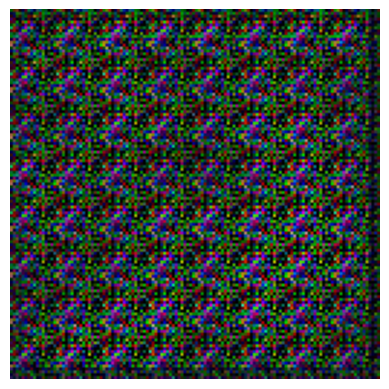

Epoch 3101 completed


Epoch 3102 completed


Epoch 3103 completed


Epoch 3104 completed


Epoch 3105 completed


Epoch 3106 completed


Epoch 3107 completed


Epoch 3108 completed


Epoch 3109 completed


Epoch 3110 completed


Epoch 3111 completed


Epoch 3112 completed


Epoch 3113 completed


Epoch 3114 completed


Epoch 3115 completed


Epoch 3116 completed


Epoch 3117 completed


Epoch 3118 completed


Epoch 3119 completed


Epoch 3120 completed


Epoch 3121 completed


Epoch 3122 completed


Epoch 3123 completed


Epoch 3124 completed


Epoch 3125 completed


Epoch 3126 completed


Epoch 3127 completed


Epoch 3128 completed


Epoch 3129 completed


Epoch 3130 completed


Epoch 3131 completed


Epoch 3132 completed


Epoch 3133 completed


Epoch 3134 completed


Epoch 3135 completed


Epoch 3136 completed


Epoch 3137 completed


Epoch 3138 completed


Epoch 3139 completed


Epoch 3140 completed


Epoch 3141 completed


Epoch 3142 completed


Epoch 3143 completed


Epoch 3144 

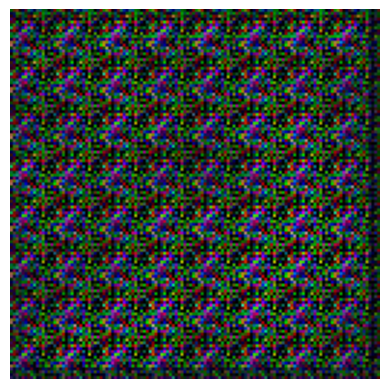

Epoch 3201 completed


Epoch 3202 completed


Epoch 3203 completed


Epoch 3204 completed


Epoch 3205 completed


Epoch 3206 completed


Epoch 3207 completed


Epoch 3208 completed


Epoch 3209 completed


Epoch 3210 completed


Epoch 3211 completed


Epoch 3212 completed


Epoch 3213 completed


Epoch 3214 completed


Epoch 3215 completed


Epoch 3216 completed


Epoch 3217 completed


Epoch 3218 completed


Epoch 3219 completed


Epoch 3220 completed


Epoch 3221 completed


Epoch 3222 completed


Epoch 3223 completed


Epoch 3224 completed


Epoch 3225 completed


Epoch 3226 completed


Epoch 3227 completed


Epoch 3228 completed


Epoch 3229 completed


Epoch 3230 completed


Epoch 3231 completed


Epoch 3232 completed


Epoch 3233 completed


Epoch 3234 completed


Epoch 3235 completed


Epoch 3236 completed


Epoch 3237 completed


Epoch 3238 completed


Epoch 3239 completed


Epoch 3240 completed


Epoch 3241 completed


Epoch 3242 completed


Epoch 3243 completed


Epoch 3244 

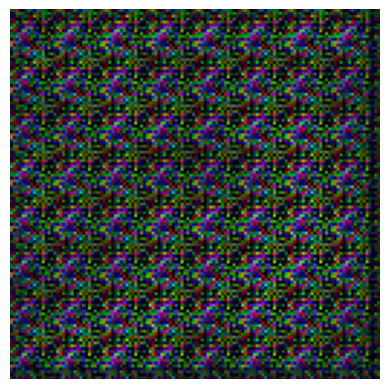

Epoch 3301 completed


Epoch 3302 completed


Epoch 3303 completed


Epoch 3304 completed


Epoch 3305 completed


Epoch 3306 completed


Epoch 3307 completed


Epoch 3308 completed


Epoch 3309 completed


Epoch 3310 completed


Epoch 3311 completed


Epoch 3312 completed


Epoch 3313 completed


Epoch 3314 completed


Epoch 3315 completed


Epoch 3316 completed


Epoch 3317 completed


Epoch 3318 completed


Epoch 3319 completed


Epoch 3320 completed


Epoch 3321 completed


Epoch 3322 completed


Epoch 3323 completed


Epoch 3324 completed


Epoch 3325 completed


Epoch 3326 completed


Epoch 3327 completed


Epoch 3328 completed


Epoch 3329 completed


Epoch 3330 completed


Epoch 3331 completed


Epoch 3332 completed


Epoch 3333 completed


Epoch 3334 completed


Epoch 3335 completed


Epoch 3336 completed


Epoch 3337 completed


Epoch 3338 completed


Epoch 3339 completed


Epoch 3340 completed


Epoch 3341 completed


Epoch 3342 completed


Epoch 3343 completed


Epoch 3344 

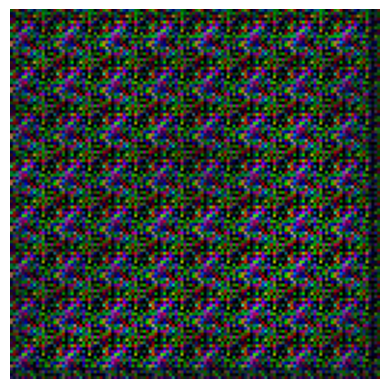

Epoch 3401 completed


Epoch 3402 completed


Epoch 3403 completed


Epoch 3404 completed


Epoch 3405 completed


Epoch 3406 completed


Epoch 3407 completed


Epoch 3408 completed


Epoch 3409 completed


Epoch 3410 completed


Epoch 3411 completed


Epoch 3412 completed


Epoch 3413 completed


Epoch 3414 completed


Epoch 3415 completed


Epoch 3416 completed


Epoch 3417 completed


Epoch 3418 completed


Epoch 3419 completed


Epoch 3420 completed


Epoch 3421 completed


Epoch 3422 completed


Epoch 3423 completed


Epoch 3424 completed


Epoch 3425 completed


Epoch 3426 completed


Epoch 3427 completed


Epoch 3428 completed


Epoch 3429 completed


Epoch 3430 completed


Epoch 3431 completed


Epoch 3432 completed


Epoch 3433 completed


Epoch 3434 completed


Epoch 3435 completed


Epoch 3436 completed


Epoch 3437 completed


Epoch 3438 completed


Epoch 3439 completed


Epoch 3440 completed


Epoch 3441 completed


Epoch 3442 completed


Epoch 3443 completed


Epoch 3444 

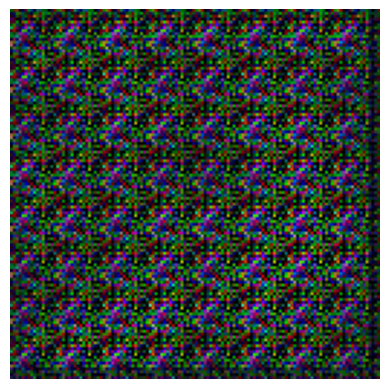

Epoch 3501 completed


Epoch 3502 completed


Epoch 3503 completed


Epoch 3504 completed


Epoch 3505 completed


Epoch 3506 completed


Epoch 3507 completed


Epoch 3508 completed


Epoch 3509 completed


Epoch 3510 completed


Epoch 3511 completed


Epoch 3512 completed


Epoch 3513 completed


Epoch 3514 completed


Epoch 3515 completed


Epoch 3516 completed


Epoch 3517 completed


Epoch 3518 completed


Epoch 3519 completed


Epoch 3520 completed


Epoch 3521 completed


Epoch 3522 completed


Epoch 3523 completed


Epoch 3524 completed


Epoch 3525 completed


Epoch 3526 completed


Epoch 3527 completed


Epoch 3528 completed


Epoch 3529 completed


Epoch 3530 completed


Epoch 3531 completed


Epoch 3532 completed


Epoch 3533 completed


Epoch 3534 completed


Epoch 3535 completed


Epoch 3536 completed


Epoch 3537 completed


Epoch 3538 completed


Epoch 3539 completed


Epoch 3540 completed


Epoch 3541 completed


Epoch 3542 completed


Epoch 3543 completed


Epoch 3544 

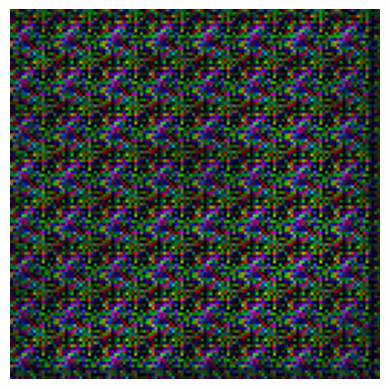

Epoch 3601 completed


Epoch 3602 completed


Epoch 3603 completed


Epoch 3604 completed


Epoch 3605 completed


Epoch 3606 completed


Epoch 3607 completed


Epoch 3608 completed


Epoch 3609 completed


Epoch 3610 completed


Epoch 3611 completed


Epoch 3612 completed


Epoch 3613 completed


Epoch 3614 completed


Epoch 3615 completed


Epoch 3616 completed


Epoch 3617 completed


Epoch 3618 completed


Epoch 3619 completed


Epoch 3620 completed


Epoch 3621 completed


Epoch 3622 completed


Epoch 3623 completed


Epoch 3624 completed


Epoch 3625 completed


Epoch 3626 completed


Epoch 3627 completed


Epoch 3628 completed


Epoch 3629 completed


Epoch 3630 completed


Epoch 3631 completed


Epoch 3632 completed


Epoch 3633 completed


Epoch 3634 completed


Epoch 3635 completed


Epoch 3636 completed


Epoch 3637 completed


Epoch 3638 completed


Epoch 3639 completed


Epoch 3640 completed


Epoch 3641 completed


Epoch 3642 completed


Epoch 3643 completed


Epoch 3644 

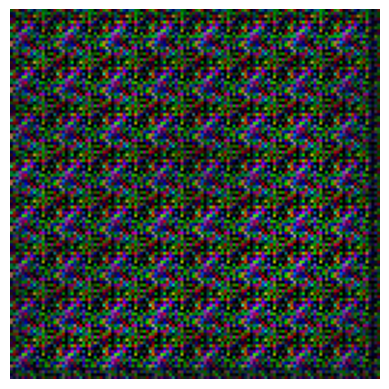

Epoch 3701 completed


Epoch 3702 completed


Epoch 3703 completed


Epoch 3704 completed


Epoch 3705 completed


Epoch 3706 completed


Epoch 3707 completed


Epoch 3708 completed


Epoch 3709 completed


Epoch 3710 completed


Epoch 3711 completed


Epoch 3712 completed


Epoch 3713 completed


Epoch 3714 completed


Epoch 3715 completed


Epoch 3716 completed


Epoch 3717 completed


Epoch 3718 completed


Epoch 3719 completed


Epoch 3720 completed


Epoch 3721 completed


Epoch 3722 completed


Epoch 3723 completed


Epoch 3724 completed


Epoch 3725 completed


Epoch 3726 completed


Epoch 3727 completed


Epoch 3728 completed


Epoch 3729 completed


Epoch 3730 completed


Epoch 3731 completed


Epoch 3732 completed


Epoch 3733 completed


Epoch 3734 completed


Epoch 3735 completed


Epoch 3736 completed


Epoch 3737 completed


Epoch 3738 completed


Epoch 3739 completed


Epoch 3740 completed


Epoch 3741 completed


Epoch 3742 completed


Epoch 3743 completed


Epoch 3744 

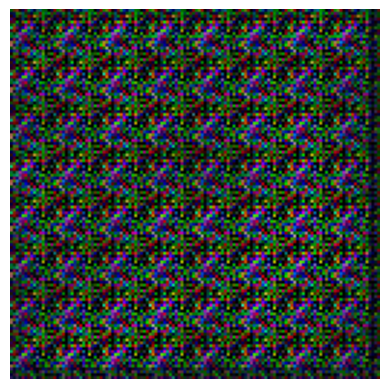

Epoch 3801 completed


Epoch 3802 completed


Epoch 3803 completed


Epoch 3804 completed


Epoch 3805 completed


Epoch 3806 completed


Epoch 3807 completed


Epoch 3808 completed


Epoch 3809 completed


Epoch 3810 completed


Epoch 3811 completed


Epoch 3812 completed


Epoch 3813 completed


Epoch 3814 completed


Epoch 3815 completed


Epoch 3816 completed


Epoch 3817 completed


Epoch 3818 completed


Epoch 3819 completed


Epoch 3820 completed


Epoch 3821 completed


Epoch 3822 completed


Epoch 3823 completed


Epoch 3824 completed


Epoch 3825 completed


Epoch 3826 completed


Epoch 3827 completed


Epoch 3828 completed


Epoch 3829 completed


Epoch 3830 completed


Epoch 3831 completed


Epoch 3832 completed


Epoch 3833 completed


Epoch 3834 completed


Epoch 3835 completed


Epoch 3836 completed


Epoch 3837 completed


Epoch 3838 completed


Epoch 3839 completed


Epoch 3840 completed


Epoch 3841 completed


Epoch 3842 completed


Epoch 3843 completed


Epoch 3844 

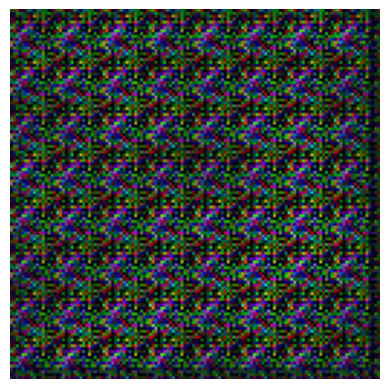

Epoch 3901 completed


Epoch 3902 completed


Epoch 3903 completed


Epoch 3904 completed


Epoch 3905 completed


Epoch 3906 completed


Epoch 3907 completed


Epoch 3908 completed


Epoch 3909 completed


Epoch 3910 completed


Epoch 3911 completed


Epoch 3912 completed


Epoch 3913 completed


Epoch 3914 completed


Epoch 3915 completed


Epoch 3916 completed


Epoch 3917 completed


Epoch 3918 completed


Epoch 3919 completed


Epoch 3920 completed


Epoch 3921 completed


Epoch 3922 completed


Epoch 3923 completed


Epoch 3924 completed


Epoch 3925 completed


Epoch 3926 completed


Epoch 3927 completed


Epoch 3928 completed


Epoch 3929 completed


Epoch 3930 completed


Epoch 3931 completed


Epoch 3932 completed


Epoch 3933 completed


Epoch 3934 completed


Epoch 3935 completed


Epoch 3936 completed


Epoch 3937 completed


Epoch 3938 completed


Epoch 3939 completed


Epoch 3940 completed


Epoch 3941 completed


Epoch 3942 completed


Epoch 3943 completed


Epoch 3944 

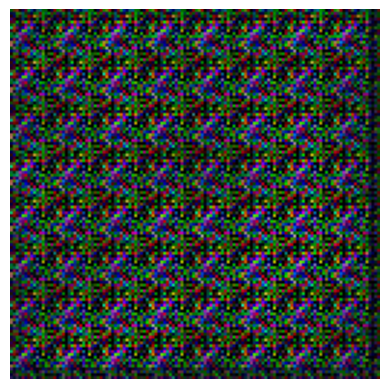

Epoch 4001 completed


Epoch 4002 completed


Epoch 4003 completed


Epoch 4004 completed


Epoch 4005 completed


Epoch 4006 completed


Epoch 4007 completed


Epoch 4008 completed


Epoch 4009 completed


Epoch 4010 completed


Epoch 4011 completed


Epoch 4012 completed


Epoch 4013 completed


Epoch 4014 completed


Epoch 4015 completed


Epoch 4016 completed


Epoch 4017 completed


Epoch 4018 completed


Epoch 4019 completed


Epoch 4020 completed


Epoch 4021 completed


Epoch 4022 completed


Epoch 4023 completed


Epoch 4024 completed


Epoch 4025 completed


Epoch 4026 completed


Epoch 4027 completed


Epoch 4028 completed


Epoch 4029 completed


Epoch 4030 completed


Epoch 4031 completed


Epoch 4032 completed


Epoch 4033 completed


Epoch 4034 completed


Epoch 4035 completed


Epoch 4036 completed


Epoch 4037 completed


Epoch 4038 completed


Epoch 4039 completed


Epoch 4040 completed


Epoch 4041 completed


Epoch 4042 completed


Epoch 4043 completed


Epoch 4044 

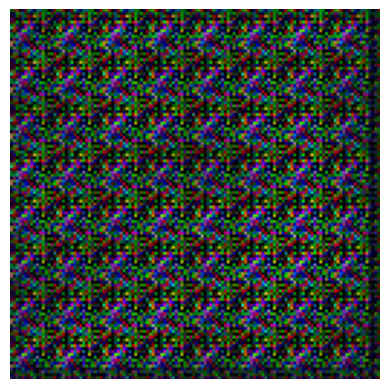

Epoch 4101 completed


Epoch 4102 completed


Epoch 4103 completed


Epoch 4104 completed


Epoch 4105 completed


Epoch 4106 completed


Epoch 4107 completed


Epoch 4108 completed


Epoch 4109 completed


Epoch 4110 completed


Epoch 4111 completed


Epoch 4112 completed


Epoch 4113 completed


Epoch 4114 completed


Epoch 4115 completed


Epoch 4116 completed


Epoch 4117 completed


Epoch 4118 completed


Epoch 4119 completed


Epoch 4120 completed


Epoch 4121 completed


Epoch 4122 completed


Epoch 4123 completed


Epoch 4124 completed


Epoch 4125 completed


Epoch 4126 completed


Epoch 4127 completed


Epoch 4128 completed


Epoch 4129 completed


Epoch 4130 completed


Epoch 4131 completed


Epoch 4132 completed


Epoch 4133 completed


Epoch 4134 completed


Epoch 4135 completed


Epoch 4136 completed


Epoch 4137 completed


Epoch 4138 completed


Epoch 4139 completed


Epoch 4140 completed


Epoch 4141 completed


Epoch 4142 completed


Epoch 4143 completed


Epoch 4144 

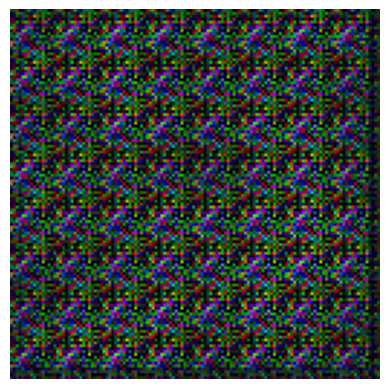

Epoch 4201 completed


Epoch 4202 completed


Epoch 4203 completed


Epoch 4204 completed


Epoch 4205 completed


Epoch 4206 completed


Epoch 4207 completed


Epoch 4208 completed


Epoch 4209 completed


Epoch 4210 completed


Epoch 4211 completed


Epoch 4212 completed


Epoch 4213 completed


Epoch 4214 completed


Epoch 4215 completed


Epoch 4216 completed


Epoch 4217 completed


Epoch 4218 completed


Epoch 4219 completed


Epoch 4220 completed


Epoch 4221 completed


Epoch 4222 completed


Epoch 4223 completed


Epoch 4224 completed


Epoch 4225 completed


Epoch 4226 completed


Epoch 4227 completed


Epoch 4228 completed


Epoch 4229 completed


Epoch 4230 completed


Epoch 4231 completed


Epoch 4232 completed


Epoch 4233 completed


Epoch 4234 completed


Epoch 4235 completed


Epoch 4236 completed


Epoch 4237 completed


Epoch 4238 completed


Epoch 4239 completed


Epoch 4240 completed


Epoch 4241 completed


Epoch 4242 completed


Epoch 4243 completed


Epoch 4244 

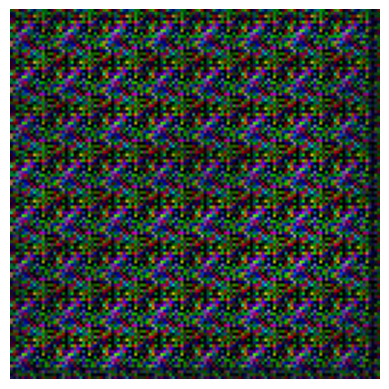

Epoch 4301 completed


Epoch 4302 completed


Epoch 4303 completed


Epoch 4304 completed


Epoch 4305 completed


Epoch 4306 completed


Epoch 4307 completed


Epoch 4308 completed


Epoch 4309 completed


Epoch 4310 completed


Epoch 4311 completed


Epoch 4312 completed


Epoch 4313 completed


Epoch 4314 completed


Epoch 4315 completed


Epoch 4316 completed


Epoch 4317 completed


Epoch 4318 completed


Epoch 4319 completed


Epoch 4320 completed


Epoch 4321 completed


Epoch 4322 completed


Epoch 4323 completed


Epoch 4324 completed


Epoch 4325 completed


Epoch 4326 completed


Epoch 4327 completed


Epoch 4328 completed


Epoch 4329 completed


Epoch 4330 completed


Epoch 4331 completed


Epoch 4332 completed


Epoch 4333 completed


Epoch 4334 completed


Epoch 4335 completed


Epoch 4336 completed


Epoch 4337 completed


Epoch 4338 completed


Epoch 4339 completed


Epoch 4340 completed


Epoch 4341 completed


Epoch 4342 completed


Epoch 4343 completed


Epoch 4344 

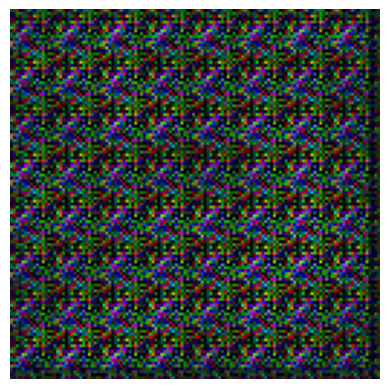

Epoch 4401 completed


Epoch 4402 completed


Epoch 4403 completed


Epoch 4404 completed


Epoch 4405 completed


Epoch 4406 completed


Epoch 4407 completed


Epoch 4408 completed


Epoch 4409 completed


Epoch 4410 completed


Epoch 4411 completed


Epoch 4412 completed


Epoch 4413 completed


Epoch 4414 completed


Epoch 4415 completed


Epoch 4416 completed


Epoch 4417 completed


Epoch 4418 completed


Epoch 4419 completed


Epoch 4420 completed


Epoch 4421 completed


Epoch 4422 completed


Epoch 4423 completed


Epoch 4424 completed


Epoch 4425 completed


Epoch 4426 completed


Epoch 4427 completed


Epoch 4428 completed


Epoch 4429 completed


Epoch 4430 completed


Epoch 4431 completed


Epoch 4432 completed


Epoch 4433 completed


Epoch 4434 completed


Epoch 4435 completed


Epoch 4436 completed


Epoch 4437 completed


Epoch 4438 completed


Epoch 4439 completed


Epoch 4440 completed


Epoch 4441 completed


Epoch 4442 completed


Epoch 4443 completed


Epoch 4444 

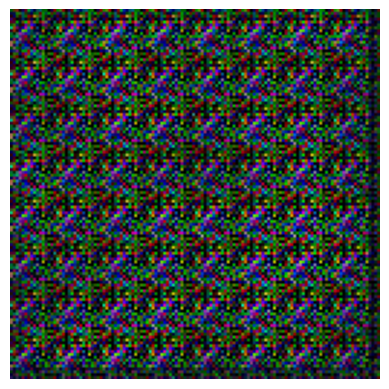

Epoch 4501 completed


Epoch 4502 completed


Epoch 4503 completed


Epoch 4504 completed


Epoch 4505 completed


Epoch 4506 completed


Epoch 4507 completed


Epoch 4508 completed


Epoch 4509 completed


Epoch 4510 completed


Epoch 4511 completed


Epoch 4512 completed


Epoch 4513 completed


Epoch 4514 completed


Epoch 4515 completed


Epoch 4516 completed


Epoch 4517 completed


Epoch 4518 completed


Epoch 4519 completed


Epoch 4520 completed


Epoch 4521 completed


Epoch 4522 completed


Epoch 4523 completed


Epoch 4524 completed


Epoch 4525 completed


Epoch 4526 completed


Epoch 4527 completed


Epoch 4528 completed


Epoch 4529 completed


Epoch 4530 completed


Epoch 4531 completed


Epoch 4532 completed


Epoch 4533 completed


Epoch 4534 completed


Epoch 4535 completed


Epoch 4536 completed


Epoch 4537 completed


Epoch 4538 completed


Epoch 4539 completed


Epoch 4540 completed


Epoch 4541 completed


Epoch 4542 completed


Epoch 4543 completed


Epoch 4544 

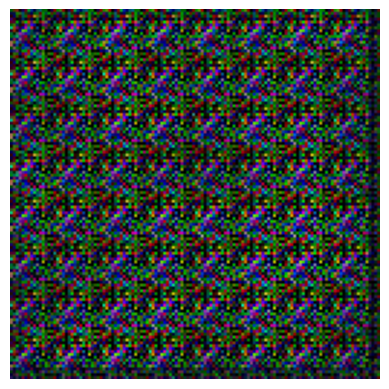

Epoch 4601 completed


Epoch 4602 completed


Epoch 4603 completed


Epoch 4604 completed


Epoch 4605 completed


Epoch 4606 completed


Epoch 4607 completed


Epoch 4608 completed


Epoch 4609 completed


Epoch 4610 completed


Epoch 4611 completed


Epoch 4612 completed


Epoch 4613 completed


Epoch 4614 completed


Epoch 4615 completed


Epoch 4616 completed


Epoch 4617 completed


Epoch 4618 completed


Epoch 4619 completed


Epoch 4620 completed


Epoch 4621 completed


Epoch 4622 completed


Epoch 4623 completed


Epoch 4624 completed


Epoch 4625 completed


Epoch 4626 completed


Epoch 4627 completed


Epoch 4628 completed


Epoch 4629 completed


Epoch 4630 completed


Epoch 4631 completed


Epoch 4632 completed


Epoch 4633 completed


Epoch 4634 completed


Epoch 4635 completed


Epoch 4636 completed


Epoch 4637 completed


Epoch 4638 completed


Epoch 4639 completed


Epoch 4640 completed


Epoch 4641 completed


Epoch 4642 completed


Epoch 4643 completed


Epoch 4644 

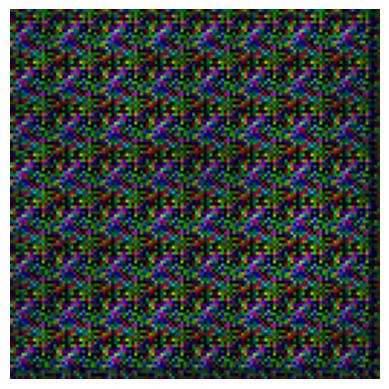

Epoch 4701 completed


Epoch 4702 completed


Epoch 4703 completed


Epoch 4704 completed


Epoch 4705 completed


Epoch 4706 completed


Epoch 4707 completed


Epoch 4708 completed


Epoch 4709 completed


Epoch 4710 completed


Epoch 4711 completed


Epoch 4712 completed


Epoch 4713 completed


Epoch 4714 completed


Epoch 4715 completed


Epoch 4716 completed


Epoch 4717 completed


Epoch 4718 completed


Epoch 4719 completed


Epoch 4720 completed


Epoch 4721 completed


Epoch 4722 completed


Epoch 4723 completed


Epoch 4724 completed


Epoch 4725 completed


Epoch 4726 completed


Epoch 4727 completed


Epoch 4728 completed


Epoch 4729 completed


Epoch 4730 completed


Epoch 4731 completed


Epoch 4732 completed


Epoch 4733 completed


Epoch 4734 completed


Epoch 4735 completed


Epoch 4736 completed


Epoch 4737 completed


Epoch 4738 completed


Epoch 4739 completed


Epoch 4740 completed


Epoch 4741 completed


Epoch 4742 completed


Epoch 4743 completed


Epoch 4744 

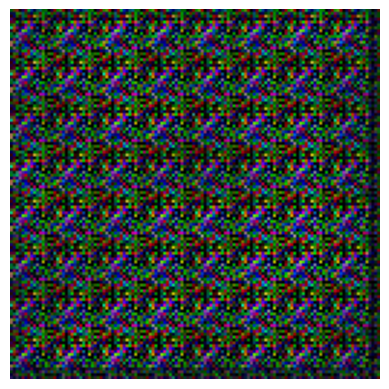

Epoch 4801 completed


Epoch 4802 completed


Epoch 4803 completed


Epoch 4804 completed


Epoch 4805 completed


Epoch 4806 completed


Epoch 4807 completed


Epoch 4808 completed


Epoch 4809 completed


Epoch 4810 completed


Epoch 4811 completed


Epoch 4812 completed


Epoch 4813 completed


Epoch 4814 completed


Epoch 4815 completed


Epoch 4816 completed


Epoch 4817 completed


Epoch 4818 completed


Epoch 4819 completed


Epoch 4820 completed


Epoch 4821 completed


Epoch 4822 completed


Epoch 4823 completed


Epoch 4824 completed


Epoch 4825 completed


Epoch 4826 completed


Epoch 4827 completed


Epoch 4828 completed


Epoch 4829 completed


Epoch 4830 completed


Epoch 4831 completed


Epoch 4832 completed


Epoch 4833 completed


Epoch 4834 completed


Epoch 4835 completed


Epoch 4836 completed


Epoch 4837 completed


Epoch 4838 completed


Epoch 4839 completed


Epoch 4840 completed


Epoch 4841 completed


Epoch 4842 completed


Epoch 4843 completed


Epoch 4844 

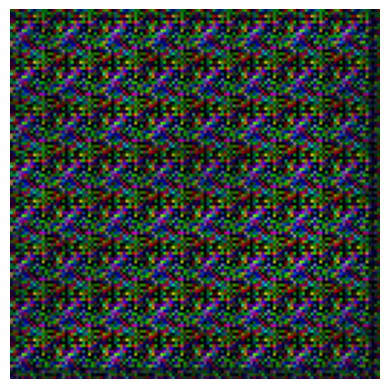

Epoch 4901 completed


Epoch 4902 completed


Epoch 4903 completed


Epoch 4904 completed


Epoch 4905 completed


Epoch 4906 completed


Epoch 4907 completed


Epoch 4908 completed


Epoch 4909 completed


Epoch 4910 completed


Epoch 4911 completed


Epoch 4912 completed


Epoch 4913 completed


Epoch 4914 completed


Epoch 4915 completed


Epoch 4916 completed


Epoch 4917 completed


Epoch 4918 completed


Epoch 4919 completed


Epoch 4920 completed


Epoch 4921 completed


Epoch 4922 completed


Epoch 4923 completed


Epoch 4924 completed


Epoch 4925 completed


Epoch 4926 completed


Epoch 4927 completed


Epoch 4928 completed


Epoch 4929 completed


Epoch 4930 completed


Epoch 4931 completed


Epoch 4932 completed


Epoch 4933 completed


Epoch 4934 completed


Epoch 4935 completed


Epoch 4936 completed


Epoch 4937 completed


Epoch 4938 completed


Epoch 4939 completed


Epoch 4940 completed


Epoch 4941 completed


Epoch 4942 completed


Epoch 4943 completed


Epoch 4944 

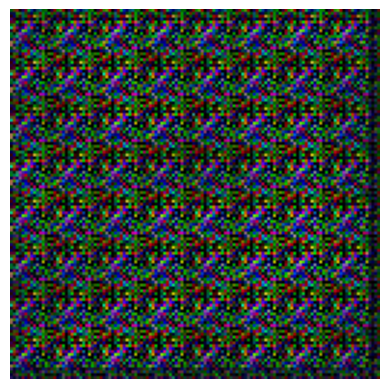

Epoch 5001 completed


Epoch 5002 completed


Epoch 5003 completed


Epoch 5004 completed


Epoch 5005 completed


Epoch 5006 completed


Epoch 5007 completed


Epoch 5008 completed


Epoch 5009 completed


Epoch 5010 completed


Epoch 5011 completed


Epoch 5012 completed


Epoch 5013 completed


Epoch 5014 completed


Epoch 5015 completed


Epoch 5016 completed


Epoch 5017 completed


Epoch 5018 completed


Epoch 5019 completed


Epoch 5020 completed


Epoch 5021 completed


Epoch 5022 completed


Epoch 5023 completed


Epoch 5024 completed


Epoch 5025 completed


Epoch 5026 completed


Epoch 5027 completed


Epoch 5028 completed


Epoch 5029 completed


Epoch 5030 completed


Epoch 5031 completed


Epoch 5032 completed


Epoch 5033 completed


Epoch 5034 completed


Epoch 5035 completed


Epoch 5036 completed


Epoch 5037 completed


Epoch 5038 completed


Epoch 5039 completed


Epoch 5040 completed


Epoch 5041 completed


Epoch 5042 completed


Epoch 5043 completed


Epoch 5044 

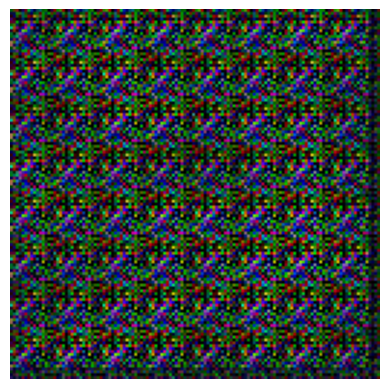

Epoch 5101 completed


Epoch 5102 completed


Epoch 5103 completed


Epoch 5104 completed


Epoch 5105 completed


Epoch 5106 completed


Epoch 5107 completed


Epoch 5108 completed


Epoch 5109 completed


Epoch 5110 completed


Epoch 5111 completed


Epoch 5112 completed


Epoch 5113 completed


Epoch 5114 completed


Epoch 5115 completed


Epoch 5116 completed


Epoch 5117 completed


Epoch 5118 completed


Epoch 5119 completed


Epoch 5120 completed


Epoch 5121 completed


Epoch 5122 completed


Epoch 5123 completed


Epoch 5124 completed


Epoch 5125 completed


Epoch 5126 completed


Epoch 5127 completed


Epoch 5128 completed


Epoch 5129 completed


Epoch 5130 completed


Epoch 5131 completed


Epoch 5132 completed


Epoch 5133 completed


Epoch 5134 completed


Epoch 5135 completed


Epoch 5136 completed


Epoch 5137 completed


Epoch 5138 completed


Epoch 5139 completed


Epoch 5140 completed


Epoch 5141 completed


Epoch 5142 completed


Epoch 5143 completed


Epoch 5144 

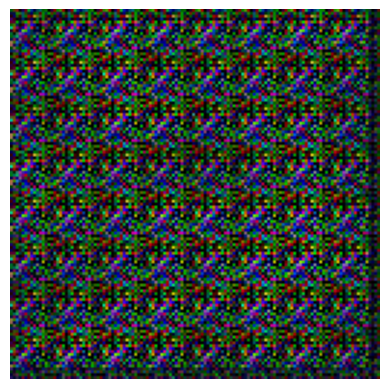

Epoch 5201 completed


Epoch 5202 completed


Epoch 5203 completed


Epoch 5204 completed


Epoch 5205 completed


Epoch 5206 completed


Epoch 5207 completed


Epoch 5208 completed


Epoch 5209 completed


Epoch 5210 completed


Epoch 5211 completed


Epoch 5212 completed


Epoch 5213 completed


Epoch 5214 completed


Epoch 5215 completed


Epoch 5216 completed


Epoch 5217 completed


Epoch 5218 completed


Epoch 5219 completed


Epoch 5220 completed


Epoch 5221 completed


Epoch 5222 completed


Epoch 5223 completed


Epoch 5224 completed


Epoch 5225 completed


Epoch 5226 completed


Epoch 5227 completed


Epoch 5228 completed


Epoch 5229 completed


Epoch 5230 completed


Epoch 5231 completed


Epoch 5232 completed


Epoch 5233 completed


Epoch 5234 completed


Epoch 5235 completed


Epoch 5236 completed


Epoch 5237 completed


Epoch 5238 completed


Epoch 5239 completed


Epoch 5240 completed


Epoch 5241 completed


Epoch 5242 completed


Epoch 5243 completed


Epoch 5244 

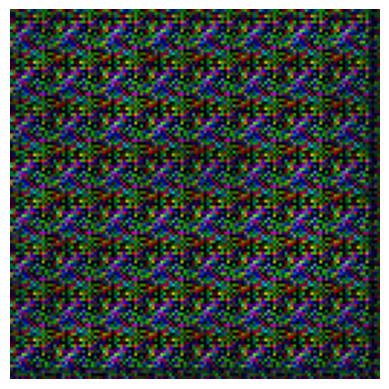

Epoch 5301 completed


Epoch 5302 completed


Epoch 5303 completed


Epoch 5304 completed


Epoch 5305 completed


Epoch 5306 completed


Epoch 5307 completed


Epoch 5308 completed


Epoch 5309 completed


Epoch 5310 completed


Epoch 5311 completed


Epoch 5312 completed


Epoch 5313 completed


Epoch 5314 completed


Epoch 5315 completed


Epoch 5316 completed


Epoch 5317 completed


Epoch 5318 completed


Epoch 5319 completed


Epoch 5320 completed


Epoch 5321 completed


Epoch 5322 completed


Epoch 5323 completed


Epoch 5324 completed


Epoch 5325 completed


Epoch 5326 completed


Epoch 5327 completed


Epoch 5328 completed


Epoch 5329 completed


Epoch 5330 completed


Epoch 5331 completed


Epoch 5332 completed


Epoch 5333 completed


Epoch 5334 completed


Epoch 5335 completed


Epoch 5336 completed


Epoch 5337 completed


Epoch 5338 completed


Epoch 5339 completed


Epoch 5340 completed


Epoch 5341 completed


Epoch 5342 completed


Epoch 5343 completed


Epoch 5344 

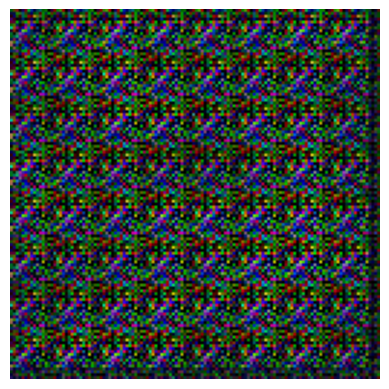

Epoch 5401 completed


Epoch 5402 completed


Epoch 5403 completed


Epoch 5404 completed


Epoch 5405 completed


Epoch 5406 completed


Epoch 5407 completed


Epoch 5408 completed


Epoch 5409 completed


Epoch 5410 completed


Epoch 5411 completed


Epoch 5412 completed


Epoch 5413 completed


Epoch 5414 completed


Epoch 5415 completed


Epoch 5416 completed


Epoch 5417 completed


Epoch 5418 completed


Epoch 5419 completed


Epoch 5420 completed


Epoch 5421 completed


Epoch 5422 completed


Epoch 5423 completed


Epoch 5424 completed


Epoch 5425 completed


Epoch 5426 completed


Epoch 5427 completed


Epoch 5428 completed


Epoch 5429 completed


Epoch 5430 completed


Epoch 5431 completed


Epoch 5432 completed


Epoch 5433 completed


Epoch 5434 completed


Epoch 5435 completed


Epoch 5436 completed


Epoch 5437 completed


Epoch 5438 completed


Epoch 5439 completed


Epoch 5440 completed


Epoch 5441 completed


Epoch 5442 completed


Epoch 5443 completed


Epoch 5444 

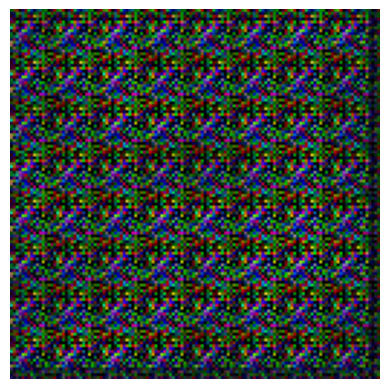

Epoch 5501 completed


Epoch 5502 completed


Epoch 5503 completed


Epoch 5504 completed


Epoch 5505 completed


Epoch 5506 completed


Epoch 5507 completed


Epoch 5508 completed


Epoch 5509 completed


Epoch 5510 completed


Epoch 5511 completed


Epoch 5512 completed


Epoch 5513 completed


Epoch 5514 completed


Epoch 5515 completed


Epoch 5516 completed


Epoch 5517 completed


Epoch 5518 completed


Epoch 5519 completed


Epoch 5520 completed


Epoch 5521 completed


Epoch 5522 completed


Epoch 5523 completed


Epoch 5524 completed


Epoch 5525 completed


Epoch 5526 completed


Epoch 5527 completed


Epoch 5528 completed


Epoch 5529 completed


Epoch 5530 completed


Epoch 5531 completed


Epoch 5532 completed


Epoch 5533 completed


Epoch 5534 completed


Epoch 5535 completed


Epoch 5536 completed


Epoch 5537 completed


Epoch 5538 completed


Epoch 5539 completed


Epoch 5540 completed


Epoch 5541 completed


Epoch 5542 completed


Epoch 5543 completed


Epoch 5544 

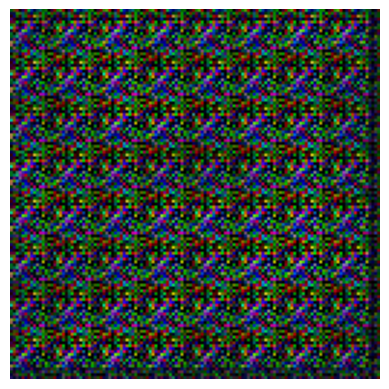

Epoch 5601 completed


Epoch 5602 completed


Epoch 5603 completed


Epoch 5604 completed


Epoch 5605 completed


Epoch 5606 completed


Epoch 5607 completed


Epoch 5608 completed


Epoch 5609 completed


Epoch 5610 completed


Epoch 5611 completed


Epoch 5612 completed


Epoch 5613 completed


Epoch 5614 completed


Epoch 5615 completed


Epoch 5616 completed


Epoch 5617 completed


Epoch 5618 completed


Epoch 5619 completed


Epoch 5620 completed


Epoch 5621 completed


Epoch 5622 completed


Epoch 5623 completed


Epoch 5624 completed


Epoch 5625 completed


Epoch 5626 completed


Epoch 5627 completed


Epoch 5628 completed


Epoch 5629 completed


Epoch 5630 completed


Epoch 5631 completed


Epoch 5632 completed


Epoch 5633 completed


Epoch 5634 completed


Epoch 5635 completed


Epoch 5636 completed


Epoch 5637 completed


Epoch 5638 completed


Epoch 5639 completed


Epoch 5640 completed


Epoch 5641 completed


Epoch 5642 completed


Epoch 5643 completed


Epoch 5644 

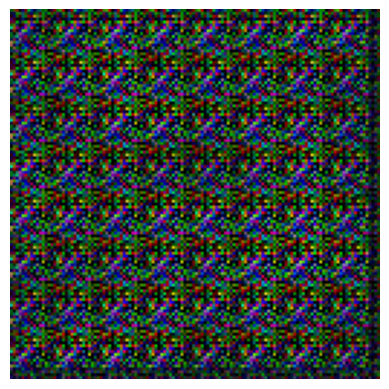

Epoch 5701 completed


Epoch 5702 completed


Epoch 5703 completed


Epoch 5704 completed


Epoch 5705 completed


Epoch 5706 completed


Epoch 5707 completed


Epoch 5708 completed


Epoch 5709 completed


Epoch 5710 completed


Epoch 5711 completed


Epoch 5712 completed


Epoch 5713 completed


Epoch 5714 completed


Epoch 5715 completed


Epoch 5716 completed


Epoch 5717 completed


Epoch 5718 completed


Epoch 5719 completed


Epoch 5720 completed


Epoch 5721 completed


Epoch 5722 completed


Epoch 5723 completed


Epoch 5724 completed


Epoch 5725 completed


Epoch 5726 completed


Epoch 5727 completed


Epoch 5728 completed


Epoch 5729 completed


Epoch 5730 completed


Epoch 5731 completed


Epoch 5732 completed


Epoch 5733 completed


Epoch 5734 completed


Epoch 5735 completed


Epoch 5736 completed


Epoch 5737 completed


Epoch 5738 completed


Epoch 5739 completed


Epoch 5740 completed


Epoch 5741 completed


Epoch 5742 completed


Epoch 5743 completed


Epoch 5744 

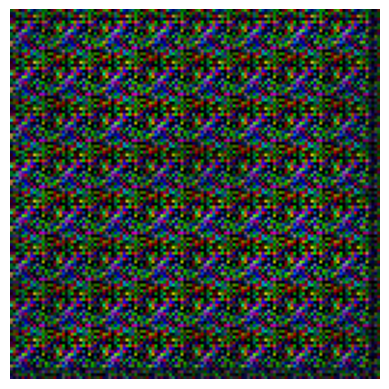

Epoch 5801 completed


Epoch 5802 completed


Epoch 5803 completed


Epoch 5804 completed


Epoch 5805 completed


Epoch 5806 completed


Epoch 5807 completed


Epoch 5808 completed


Epoch 5809 completed


Epoch 5810 completed


Epoch 5811 completed


Epoch 5812 completed


Epoch 5813 completed


Epoch 5814 completed


Epoch 5815 completed


Epoch 5816 completed


Epoch 5817 completed


Epoch 5818 completed


Epoch 5819 completed


Epoch 5820 completed


Epoch 5821 completed


Epoch 5822 completed


Epoch 5823 completed


Epoch 5824 completed


Epoch 5825 completed


Epoch 5826 completed


Epoch 5827 completed


Epoch 5828 completed


Epoch 5829 completed


Epoch 5830 completed


Epoch 5831 completed


Epoch 5832 completed


Epoch 5833 completed


Epoch 5834 completed


Epoch 5835 completed


Epoch 5836 completed


Epoch 5837 completed


Epoch 5838 completed


Epoch 5839 completed


Epoch 5840 completed


Epoch 5841 completed


Epoch 5842 completed


Epoch 5843 completed


Epoch 5844 

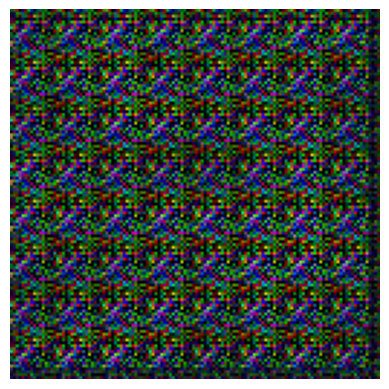

Epoch 5901 completed


Epoch 5902 completed


Epoch 5903 completed


Epoch 5904 completed


Epoch 5905 completed


Epoch 5906 completed


Epoch 5907 completed


Epoch 5908 completed


Epoch 5909 completed


Epoch 5910 completed


Epoch 5911 completed


Epoch 5912 completed


Epoch 5913 completed


Epoch 5914 completed


Epoch 5915 completed


Epoch 5916 completed


Epoch 5917 completed


Epoch 5918 completed


Epoch 5919 completed


Epoch 5920 completed


Epoch 5921 completed


Epoch 5922 completed


Epoch 5923 completed


Epoch 5924 completed


Epoch 5925 completed


Epoch 5926 completed


Epoch 5927 completed


Epoch 5928 completed


Epoch 5929 completed


Epoch 5930 completed


Epoch 5931 completed


Epoch 5932 completed


Epoch 5933 completed


Epoch 5934 completed


Epoch 5935 completed


Epoch 5936 completed


Epoch 5937 completed


Epoch 5938 completed


Epoch 5939 completed


Epoch 5940 completed


Epoch 5941 completed


Epoch 5942 completed


Epoch 5943 completed


Epoch 5944 

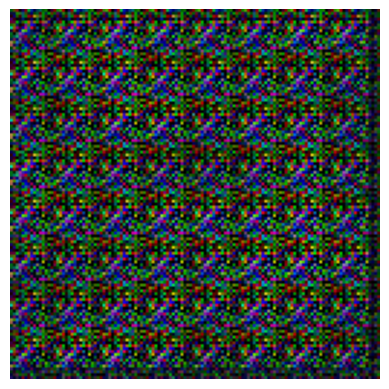

Epoch 6001 completed


Epoch 6002 completed


Epoch 6003 completed


Epoch 6004 completed


Epoch 6005 completed


Epoch 6006 completed


Epoch 6007 completed


Epoch 6008 completed


Epoch 6009 completed


Epoch 6010 completed


Epoch 6011 completed


Epoch 6012 completed


Epoch 6013 completed


Epoch 6014 completed


Epoch 6015 completed


Epoch 6016 completed


Epoch 6017 completed


Epoch 6018 completed


Epoch 6019 completed


Epoch 6020 completed


Epoch 6021 completed


Epoch 6022 completed


Epoch 6023 completed


Epoch 6024 completed


Epoch 6025 completed


Epoch 6026 completed


Epoch 6027 completed


Epoch 6028 completed


Epoch 6029 completed


Epoch 6030 completed


Epoch 6031 completed


Epoch 6032 completed


Epoch 6033 completed


Epoch 6034 completed


Epoch 6035 completed


Epoch 6036 completed


Epoch 6037 completed


Epoch 6038 completed


Epoch 6039 completed


Epoch 6040 completed


Epoch 6041 completed


Epoch 6042 completed


Epoch 6043 completed


Epoch 6044 

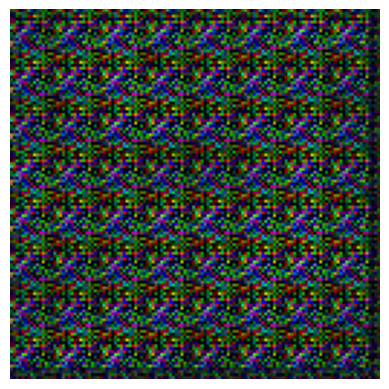

Epoch 6101 completed


Epoch 6102 completed


Epoch 6103 completed


Epoch 6104 completed


Epoch 6105 completed


Epoch 6106 completed


Epoch 6107 completed


Epoch 6108 completed


Epoch 6109 completed


Epoch 6110 completed


Epoch 6111 completed


Epoch 6112 completed


Epoch 6113 completed


Epoch 6114 completed


Epoch 6115 completed


Epoch 6116 completed


Epoch 6117 completed


Epoch 6118 completed


Epoch 6119 completed


Epoch 6120 completed


Epoch 6121 completed


Epoch 6122 completed


Epoch 6123 completed


Epoch 6124 completed


Epoch 6125 completed


Epoch 6126 completed


Epoch 6127 completed


Epoch 6128 completed


Epoch 6129 completed


Epoch 6130 completed


Epoch 6131 completed


Epoch 6132 completed


Epoch 6133 completed


Epoch 6134 completed


Epoch 6135 completed


Epoch 6136 completed


Epoch 6137 completed


Epoch 6138 completed


Epoch 6139 completed


Epoch 6140 completed


Epoch 6141 completed


Epoch 6142 completed


Epoch 6143 completed


Epoch 6144 

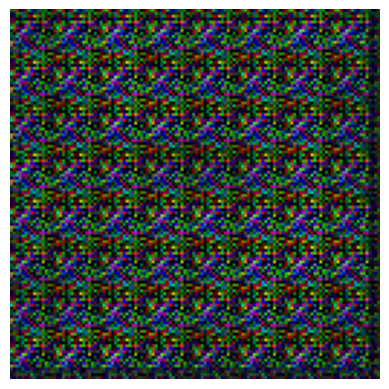

Epoch 6201 completed


Epoch 6202 completed


Epoch 6203 completed


Epoch 6204 completed


Epoch 6205 completed


Epoch 6206 completed


Epoch 6207 completed


Epoch 6208 completed


Epoch 6209 completed


Epoch 6210 completed


Epoch 6211 completed


Epoch 6212 completed


Epoch 6213 completed


Epoch 6214 completed


Epoch 6215 completed


Epoch 6216 completed


Epoch 6217 completed


Epoch 6218 completed


Epoch 6219 completed


Epoch 6220 completed


Epoch 6221 completed


Epoch 6222 completed


Epoch 6223 completed


Epoch 6224 completed


Epoch 6225 completed


Epoch 6226 completed


Epoch 6227 completed


Epoch 6228 completed


Epoch 6229 completed


Epoch 6230 completed


Epoch 6231 completed


Epoch 6232 completed


Epoch 6233 completed


Epoch 6234 completed


Epoch 6235 completed


Epoch 6236 completed


Epoch 6237 completed


Epoch 6238 completed


Epoch 6239 completed


Epoch 6240 completed


Epoch 6241 completed


Epoch 6242 completed


Epoch 6243 completed


Epoch 6244 

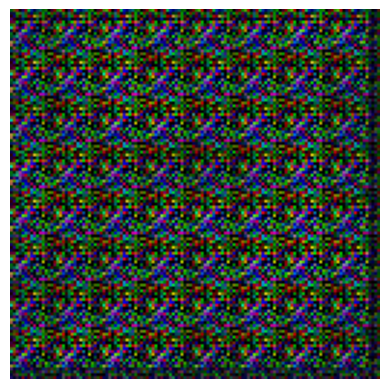

Epoch 6301 completed


Epoch 6302 completed


Epoch 6303 completed


Epoch 6304 completed


Epoch 6305 completed


Epoch 6306 completed


Epoch 6307 completed


Epoch 6308 completed


Epoch 6309 completed


Epoch 6310 completed


Epoch 6311 completed


Epoch 6312 completed


Epoch 6313 completed


Epoch 6314 completed


Epoch 6315 completed


Epoch 6316 completed


Epoch 6317 completed


Epoch 6318 completed


Epoch 6319 completed


Epoch 6320 completed


Epoch 6321 completed


Epoch 6322 completed


Epoch 6323 completed


Epoch 6324 completed


Epoch 6325 completed


Epoch 6326 completed


Epoch 6327 completed


Epoch 6328 completed


Epoch 6329 completed


Epoch 6330 completed


Epoch 6331 completed


Epoch 6332 completed


Epoch 6333 completed


Epoch 6334 completed


Epoch 6335 completed


Epoch 6336 completed


Epoch 6337 completed


Epoch 6338 completed


Epoch 6339 completed


Epoch 6340 completed


Epoch 6341 completed


Epoch 6342 completed


Epoch 6343 completed


Epoch 6344 

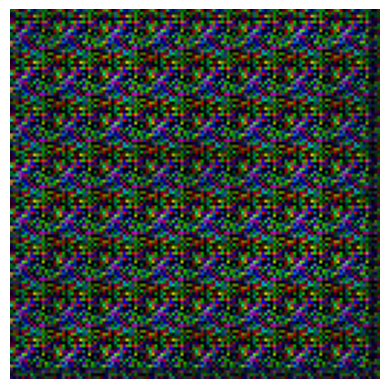

Epoch 6401 completed


Epoch 6402 completed


Epoch 6403 completed


Epoch 6404 completed


Epoch 6405 completed


Epoch 6406 completed


Epoch 6407 completed


Epoch 6408 completed


Epoch 6409 completed


Epoch 6410 completed


Epoch 6411 completed


Epoch 6412 completed


Epoch 6413 completed


Epoch 6414 completed


Epoch 6415 completed


Epoch 6416 completed


Epoch 6417 completed


Epoch 6418 completed


Epoch 6419 completed


Epoch 6420 completed


Epoch 6421 completed


Epoch 6422 completed


Epoch 6423 completed


Epoch 6424 completed


Epoch 6425 completed


Epoch 6426 completed


Epoch 6427 completed


Epoch 6428 completed


Epoch 6429 completed


Epoch 6430 completed


Epoch 6431 completed


Epoch 6432 completed


Epoch 6433 completed


Epoch 6434 completed


Epoch 6435 completed


Epoch 6436 completed


Epoch 6437 completed


Epoch 6438 completed


Epoch 6439 completed


Epoch 6440 completed


Epoch 6441 completed


Epoch 6442 completed


Epoch 6443 completed


Epoch 6444 

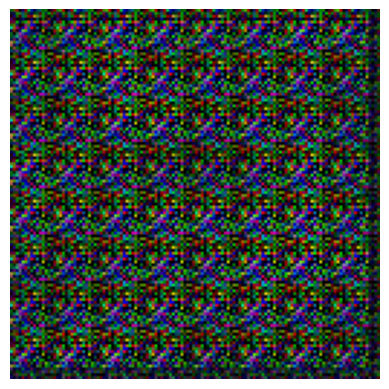

Epoch 6501 completed


Epoch 6502 completed


Epoch 6503 completed


Epoch 6504 completed


Epoch 6505 completed


Epoch 6506 completed


Epoch 6507 completed


Epoch 6508 completed


Epoch 6509 completed


Epoch 6510 completed


Epoch 6511 completed


Epoch 6512 completed


Epoch 6513 completed


Epoch 6514 completed


Epoch 6515 completed


Epoch 6516 completed


Epoch 6517 completed


Epoch 6518 completed


Epoch 6519 completed


Epoch 6520 completed


Epoch 6521 completed


Epoch 6522 completed


Epoch 6523 completed


Epoch 6524 completed


Epoch 6525 completed


Epoch 6526 completed


Epoch 6527 completed


Epoch 6528 completed


Epoch 6529 completed


Epoch 6530 completed


Epoch 6531 completed


Epoch 6532 completed


Epoch 6533 completed


Epoch 6534 completed


Epoch 6535 completed


Epoch 6536 completed


Epoch 6537 completed


Epoch 6538 completed


Epoch 6539 completed


Epoch 6540 completed


Epoch 6541 completed


Epoch 6542 completed


Epoch 6543 completed


Epoch 6544 

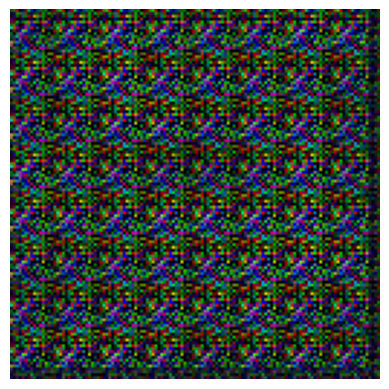

Epoch 6601 completed


Epoch 6602 completed


Epoch 6603 completed


Epoch 6604 completed


Epoch 6605 completed


Epoch 6606 completed


Epoch 6607 completed


Epoch 6608 completed


Epoch 6609 completed


Epoch 6610 completed


Epoch 6611 completed


Epoch 6612 completed


Epoch 6613 completed


Epoch 6614 completed


Epoch 6615 completed


Epoch 6616 completed


Epoch 6617 completed


Epoch 6618 completed


Epoch 6619 completed


Epoch 6620 completed


Epoch 6621 completed


Epoch 6622 completed


Epoch 6623 completed


Epoch 6624 completed


Epoch 6625 completed


Epoch 6626 completed


Epoch 6627 completed


Epoch 6628 completed


Epoch 6629 completed


Epoch 6630 completed


Epoch 6631 completed


Epoch 6632 completed


Epoch 6633 completed


Epoch 6634 completed


Epoch 6635 completed


Epoch 6636 completed


Epoch 6637 completed


Epoch 6638 completed


Epoch 6639 completed


Epoch 6640 completed


Epoch 6641 completed


Epoch 6642 completed


Epoch 6643 completed


Epoch 6644 

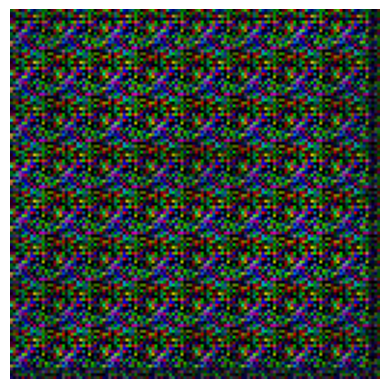

Epoch 6701 completed


Epoch 6702 completed


Epoch 6703 completed


Epoch 6704 completed


Epoch 6705 completed


Epoch 6706 completed


Epoch 6707 completed


Epoch 6708 completed


Epoch 6709 completed


Epoch 6710 completed


Epoch 6711 completed


Epoch 6712 completed


Epoch 6713 completed


Epoch 6714 completed


Epoch 6715 completed


Epoch 6716 completed


Epoch 6717 completed


Epoch 6718 completed


Epoch 6719 completed


Epoch 6720 completed


Epoch 6721 completed


Epoch 6722 completed


Epoch 6723 completed


Epoch 6724 completed


Epoch 6725 completed


Epoch 6726 completed


Epoch 6727 completed


Epoch 6728 completed


Epoch 6729 completed


Epoch 6730 completed


Epoch 6731 completed


Epoch 6732 completed


Epoch 6733 completed


Epoch 6734 completed


Epoch 6735 completed


Epoch 6736 completed


Epoch 6737 completed


Epoch 6738 completed


Epoch 6739 completed


Epoch 6740 completed


Epoch 6741 completed


Epoch 6742 completed


Epoch 6743 completed


Epoch 6744 

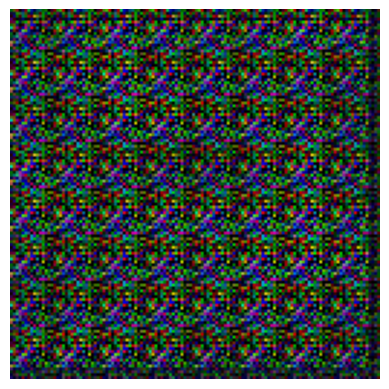

Epoch 6801 completed


Epoch 6802 completed


Epoch 6803 completed


Epoch 6804 completed


Epoch 6805 completed


Epoch 6806 completed


Epoch 6807 completed


Epoch 6808 completed


Epoch 6809 completed


Epoch 6810 completed


Epoch 6811 completed


Epoch 6812 completed


Epoch 6813 completed


Epoch 6814 completed


Epoch 6815 completed


Epoch 6816 completed


Epoch 6817 completed


Epoch 6818 completed


Epoch 6819 completed


Epoch 6820 completed


Epoch 6821 completed


Epoch 6822 completed


Epoch 6823 completed


Epoch 6824 completed


Epoch 6825 completed


Epoch 6826 completed


Epoch 6827 completed


Epoch 6828 completed


Epoch 6829 completed


Epoch 6830 completed


Epoch 6831 completed


Epoch 6832 completed


Epoch 6833 completed


Epoch 6834 completed


Epoch 6835 completed


Epoch 6836 completed


Epoch 6837 completed


Epoch 6838 completed


Epoch 6839 completed


Epoch 6840 completed


Epoch 6841 completed


Epoch 6842 completed


Epoch 6843 completed


Epoch 6844 

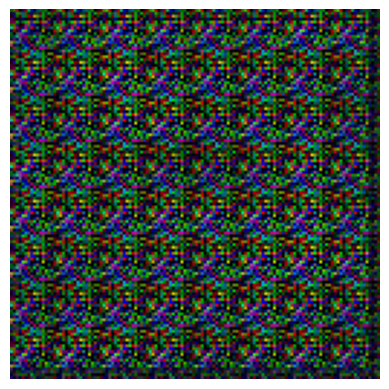

Epoch 6901 completed


Epoch 6902 completed


Epoch 6903 completed


Epoch 6904 completed


Epoch 6905 completed


Epoch 6906 completed


Epoch 6907 completed


Epoch 6908 completed


Epoch 6909 completed


Epoch 6910 completed


Epoch 6911 completed


Epoch 6912 completed


Epoch 6913 completed


Epoch 6914 completed


Epoch 6915 completed


Epoch 6916 completed


Epoch 6917 completed


Epoch 6918 completed


Epoch 6919 completed


Epoch 6920 completed


Epoch 6921 completed


Epoch 6922 completed


Epoch 6923 completed


Epoch 6924 completed


Epoch 6925 completed


Epoch 6926 completed


Epoch 6927 completed


Epoch 6928 completed


Epoch 6929 completed


Epoch 6930 completed


Epoch 6931 completed


Epoch 6932 completed


Epoch 6933 completed


Epoch 6934 completed


Epoch 6935 completed


Epoch 6936 completed


Epoch 6937 completed


Epoch 6938 completed


Epoch 6939 completed


Epoch 6940 completed


Epoch 6941 completed


Epoch 6942 completed


Epoch 6943 completed


Epoch 6944 

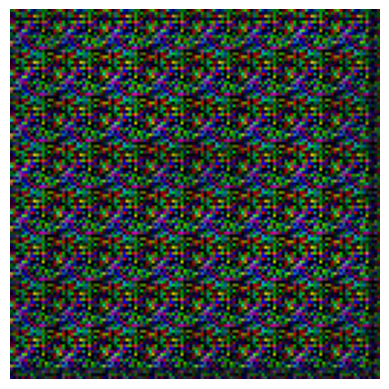

Epoch 7001 completed


Epoch 7002 completed


Epoch 7003 completed


Epoch 7004 completed


Epoch 7005 completed


Epoch 7006 completed


Epoch 7007 completed


Epoch 7008 completed


Epoch 7009 completed


Epoch 7010 completed


Epoch 7011 completed


Epoch 7012 completed


Epoch 7013 completed


Epoch 7014 completed


Epoch 7015 completed


Epoch 7016 completed


Epoch 7017 completed


Epoch 7018 completed


Epoch 7019 completed


Epoch 7020 completed


Epoch 7021 completed


Epoch 7022 completed


Epoch 7023 completed


Epoch 7024 completed


Epoch 7025 completed


Epoch 7026 completed


Epoch 7027 completed


Epoch 7028 completed


Epoch 7029 completed


Epoch 7030 completed


Epoch 7031 completed


Epoch 7032 completed


Epoch 7033 completed


Epoch 7034 completed


Epoch 7035 completed


Epoch 7036 completed


Epoch 7037 completed


Epoch 7038 completed


Epoch 7039 completed


Epoch 7040 completed


Epoch 7041 completed


Epoch 7042 completed


Epoch 7043 completed


Epoch 7044 

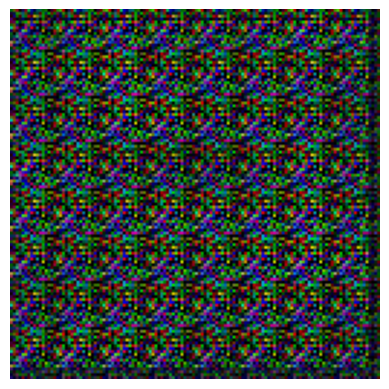

Epoch 7101 completed


Epoch 7102 completed


Epoch 7103 completed


Epoch 7104 completed


Epoch 7105 completed


Epoch 7106 completed


Epoch 7107 completed


Epoch 7108 completed


Epoch 7109 completed


Epoch 7110 completed


Epoch 7111 completed


Epoch 7112 completed


Epoch 7113 completed


Epoch 7114 completed


Epoch 7115 completed


Epoch 7116 completed


Epoch 7117 completed


Epoch 7118 completed


Epoch 7119 completed


Epoch 7120 completed


Epoch 7121 completed


Epoch 7122 completed


Epoch 7123 completed


Epoch 7124 completed


Epoch 7125 completed


Epoch 7126 completed


Epoch 7127 completed


Epoch 7128 completed


Epoch 7129 completed


Epoch 7130 completed


Epoch 7131 completed


Epoch 7132 completed


Epoch 7133 completed


Epoch 7134 completed


Epoch 7135 completed


Epoch 7136 completed


Epoch 7137 completed


Epoch 7138 completed


Epoch 7139 completed


Epoch 7140 completed


Epoch 7141 completed


Epoch 7142 completed


Epoch 7143 completed


Epoch 7144 

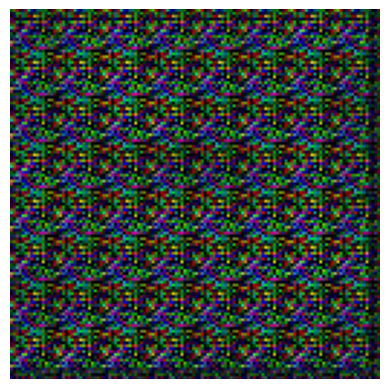

Epoch 7201 completed


Epoch 7202 completed


Epoch 7203 completed


Epoch 7204 completed


Epoch 7205 completed


Epoch 7206 completed


Epoch 7207 completed


Epoch 7208 completed


Epoch 7209 completed


Epoch 7210 completed


Epoch 7211 completed


Epoch 7212 completed


Epoch 7213 completed


Epoch 7214 completed


Epoch 7215 completed


Epoch 7216 completed


Epoch 7217 completed


Epoch 7218 completed


Epoch 7219 completed


Epoch 7220 completed


Epoch 7221 completed


Epoch 7222 completed


Epoch 7223 completed


Epoch 7224 completed


Epoch 7225 completed


Epoch 7226 completed


Epoch 7227 completed


Epoch 7228 completed


Epoch 7229 completed


Epoch 7230 completed


Epoch 7231 completed


Epoch 7232 completed


Epoch 7233 completed


Epoch 7234 completed


Epoch 7235 completed


Epoch 7236 completed


Epoch 7237 completed


Epoch 7238 completed


Epoch 7239 completed


Epoch 7240 completed


Epoch 7241 completed


Epoch 7242 completed


Epoch 7243 completed


Epoch 7244 

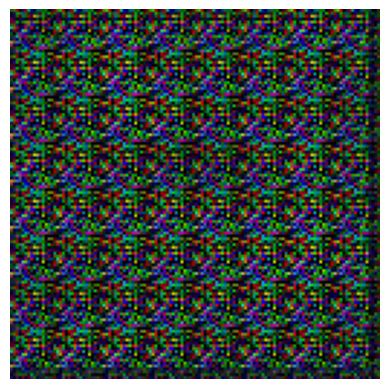

Epoch 7301 completed


Epoch 7302 completed


Epoch 7303 completed


Epoch 7304 completed


Epoch 7305 completed


Epoch 7306 completed


Epoch 7307 completed


Epoch 7308 completed


Epoch 7309 completed


Epoch 7310 completed


Epoch 7311 completed


Epoch 7312 completed


Epoch 7313 completed


Epoch 7314 completed


Epoch 7315 completed


Epoch 7316 completed


Epoch 7317 completed


Epoch 7318 completed


Epoch 7319 completed


Epoch 7320 completed


Epoch 7321 completed


Epoch 7322 completed


Epoch 7323 completed


Epoch 7324 completed


Epoch 7325 completed


Epoch 7326 completed


Epoch 7327 completed


Epoch 7328 completed


Epoch 7329 completed


Epoch 7330 completed


Epoch 7331 completed


Epoch 7332 completed


Epoch 7333 completed


Epoch 7334 completed


Epoch 7335 completed


Epoch 7336 completed


Epoch 7337 completed


Epoch 7338 completed


Epoch 7339 completed


Epoch 7340 completed


Epoch 7341 completed


Epoch 7342 completed


Epoch 7343 completed


Epoch 7344 

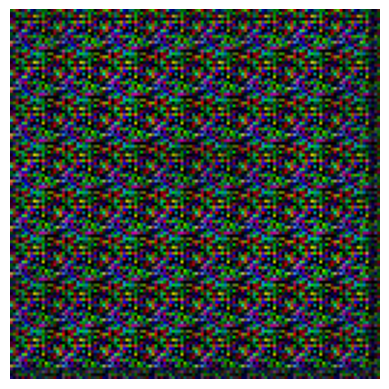

Epoch 7401 completed


Epoch 7402 completed


Epoch 7403 completed


Epoch 7404 completed


Epoch 7405 completed


Epoch 7406 completed


Epoch 7407 completed


Epoch 7408 completed


Epoch 7409 completed


Epoch 7410 completed


Epoch 7411 completed


Epoch 7412 completed


Epoch 7413 completed


Epoch 7414 completed


Epoch 7415 completed


Epoch 7416 completed


Epoch 7417 completed


Epoch 7418 completed


Epoch 7419 completed


Epoch 7420 completed


Epoch 7421 completed


Epoch 7422 completed


Epoch 7423 completed


Epoch 7424 completed


Epoch 7425 completed


Epoch 7426 completed


Epoch 7427 completed


Epoch 7428 completed


Epoch 7429 completed


Epoch 7430 completed


Epoch 7431 completed


Epoch 7432 completed


Epoch 7433 completed


Epoch 7434 completed


Epoch 7435 completed


Epoch 7436 completed


Epoch 7437 completed


Epoch 7438 completed


Epoch 7439 completed


Epoch 7440 completed


Epoch 7441 completed


Epoch 7442 completed


Epoch 7443 completed


Epoch 7444 

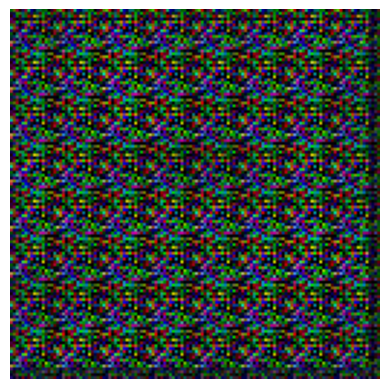

Epoch 7501 completed


Epoch 7502 completed


Epoch 7503 completed


Epoch 7504 completed


Epoch 7505 completed


Epoch 7506 completed


Epoch 7507 completed


Epoch 7508 completed


Epoch 7509 completed


Epoch 7510 completed


Epoch 7511 completed


Epoch 7512 completed


Epoch 7513 completed


Epoch 7514 completed


Epoch 7515 completed


Epoch 7516 completed


Epoch 7517 completed


Epoch 7518 completed


Epoch 7519 completed


Epoch 7520 completed


Epoch 7521 completed


Epoch 7522 completed


Epoch 7523 completed


Epoch 7524 completed


Epoch 7525 completed


Epoch 7526 completed


Epoch 7527 completed


Epoch 7528 completed


Epoch 7529 completed


Epoch 7530 completed


Epoch 7531 completed


Epoch 7532 completed


Epoch 7533 completed


Epoch 7534 completed


Epoch 7535 completed


Epoch 7536 completed


Epoch 7537 completed


Epoch 7538 completed


Epoch 7539 completed


Epoch 7540 completed


Epoch 7541 completed


Epoch 7542 completed


Epoch 7543 completed


Epoch 7544 

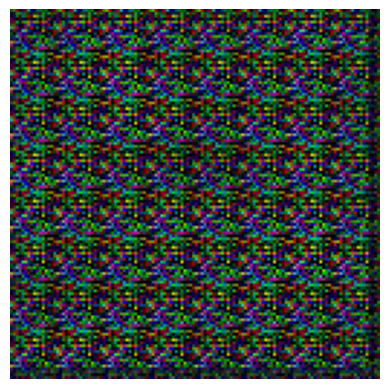

Epoch 7601 completed


Epoch 7602 completed


Epoch 7603 completed


Epoch 7604 completed


Epoch 7605 completed


Epoch 7606 completed


Epoch 7607 completed


Epoch 7608 completed


Epoch 7609 completed


Epoch 7610 completed


Epoch 7611 completed


Epoch 7612 completed


Epoch 7613 completed


Epoch 7614 completed


Epoch 7615 completed


Epoch 7616 completed


Epoch 7617 completed


Epoch 7618 completed


Epoch 7619 completed


Epoch 7620 completed


Epoch 7621 completed


Epoch 7622 completed


Epoch 7623 completed


Epoch 7624 completed


Epoch 7625 completed


Epoch 7626 completed


Epoch 7627 completed


Epoch 7628 completed


Epoch 7629 completed


Epoch 7630 completed


Epoch 7631 completed


Epoch 7632 completed


Epoch 7633 completed


Epoch 7634 completed


Epoch 7635 completed


Epoch 7636 completed


Epoch 7637 completed


Epoch 7638 completed


Epoch 7639 completed


Epoch 7640 completed


Epoch 7641 completed


Epoch 7642 completed


Epoch 7643 completed


Epoch 7644 

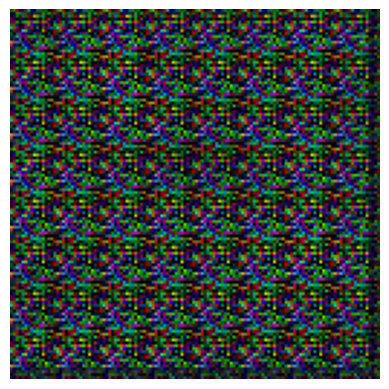

Epoch 7701 completed


Epoch 7702 completed


Epoch 7703 completed


Epoch 7704 completed


Epoch 7705 completed


Epoch 7706 completed


Epoch 7707 completed


Epoch 7708 completed


Epoch 7709 completed


Epoch 7710 completed


Epoch 7711 completed


Epoch 7712 completed


Epoch 7713 completed


Epoch 7714 completed


Epoch 7715 completed


Epoch 7716 completed


Epoch 7717 completed


Epoch 7718 completed


Epoch 7719 completed


Epoch 7720 completed


Epoch 7721 completed


Epoch 7722 completed


Epoch 7723 completed


Epoch 7724 completed


Epoch 7725 completed


Epoch 7726 completed


Epoch 7727 completed


Epoch 7728 completed


Epoch 7729 completed


Epoch 7730 completed


Epoch 7731 completed


Epoch 7732 completed


Epoch 7733 completed


Epoch 7734 completed


Epoch 7735 completed


Epoch 7736 completed


Epoch 7737 completed


Epoch 7738 completed


Epoch 7739 completed


Epoch 7740 completed


Epoch 7741 completed


Epoch 7742 completed


Epoch 7743 completed


Epoch 7744 

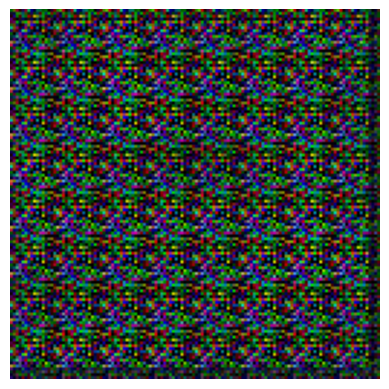

Epoch 7801 completed


Epoch 7802 completed


Epoch 7803 completed


Epoch 7804 completed


Epoch 7805 completed


Epoch 7806 completed


Epoch 7807 completed


Epoch 7808 completed


Epoch 7809 completed


Epoch 7810 completed


Epoch 7811 completed


Epoch 7812 completed


Epoch 7813 completed


Epoch 7814 completed


Epoch 7815 completed


Epoch 7816 completed


Epoch 7817 completed


Epoch 7818 completed


Epoch 7819 completed


Epoch 7820 completed


Epoch 7821 completed


Epoch 7822 completed


Epoch 7823 completed


Epoch 7824 completed


Epoch 7825 completed


Epoch 7826 completed


Epoch 7827 completed


Epoch 7828 completed


Epoch 7829 completed


Epoch 7830 completed


Epoch 7831 completed


Epoch 7832 completed


Epoch 7833 completed


Epoch 7834 completed


Epoch 7835 completed


Epoch 7836 completed


Epoch 7837 completed


Epoch 7838 completed


Epoch 7839 completed


Epoch 7840 completed


Epoch 7841 completed


Epoch 7842 completed


Epoch 7843 completed


Epoch 7844 

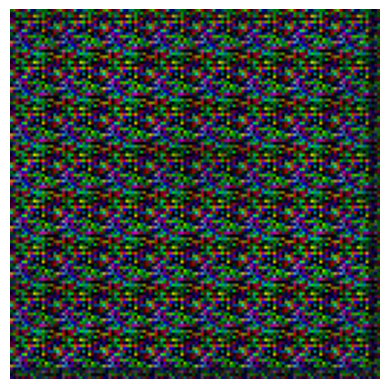

Epoch 7901 completed


Epoch 7902 completed


Epoch 7903 completed


Epoch 7904 completed


Epoch 7905 completed


Epoch 7906 completed


Epoch 7907 completed


Epoch 7908 completed


Epoch 7909 completed


Epoch 7910 completed


Epoch 7911 completed


Epoch 7912 completed


Epoch 7913 completed


Epoch 7914 completed


Epoch 7915 completed


Epoch 7916 completed


Epoch 7917 completed


Epoch 7918 completed


Epoch 7919 completed


Epoch 7920 completed


Epoch 7921 completed


Epoch 7922 completed


Epoch 7923 completed


Epoch 7924 completed


Epoch 7925 completed


Epoch 7926 completed


Epoch 7927 completed


Epoch 7928 completed


Epoch 7929 completed


Epoch 7930 completed


Epoch 7931 completed


Epoch 7932 completed


Epoch 7933 completed


Epoch 7934 completed


Epoch 7935 completed


Epoch 7936 completed


Epoch 7937 completed


Epoch 7938 completed


Epoch 7939 completed


Epoch 7940 completed


Epoch 7941 completed


Epoch 7942 completed


Epoch 7943 completed


Epoch 7944 

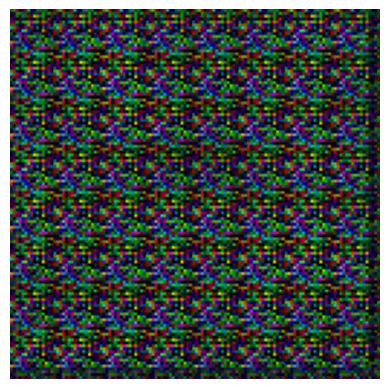

Epoch 8001 completed


Epoch 8002 completed


Epoch 8003 completed


Epoch 8004 completed


Epoch 8005 completed


Epoch 8006 completed


Epoch 8007 completed


Epoch 8008 completed


Epoch 8009 completed


Epoch 8010 completed


Epoch 8011 completed


Epoch 8012 completed


Epoch 8013 completed


Epoch 8014 completed


Epoch 8015 completed


Epoch 8016 completed


Epoch 8017 completed


Epoch 8018 completed


Epoch 8019 completed


Epoch 8020 completed


Epoch 8021 completed


Epoch 8022 completed


Epoch 8023 completed


Epoch 8024 completed


Epoch 8025 completed


Epoch 8026 completed


Epoch 8027 completed


Epoch 8028 completed


Epoch 8029 completed


Epoch 8030 completed


Epoch 8031 completed


Epoch 8032 completed


Epoch 8033 completed


Epoch 8034 completed


Epoch 8035 completed


Epoch 8036 completed


Epoch 8037 completed


Epoch 8038 completed


Epoch 8039 completed


Epoch 8040 completed


Epoch 8041 completed


Epoch 8042 completed


Epoch 8043 completed


Epoch 8044 

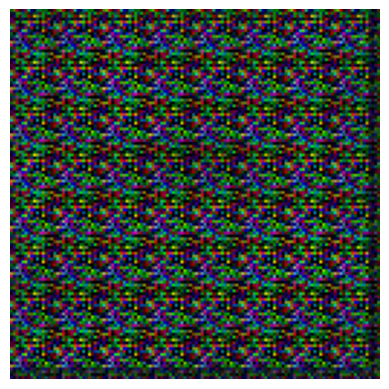

Epoch 8101 completed


Epoch 8102 completed


Epoch 8103 completed


Epoch 8104 completed


Epoch 8105 completed


Epoch 8106 completed


Epoch 8107 completed


Epoch 8108 completed


Epoch 8109 completed


Epoch 8110 completed


Epoch 8111 completed


Epoch 8112 completed


Epoch 8113 completed


Epoch 8114 completed


Epoch 8115 completed


Epoch 8116 completed


Epoch 8117 completed


Epoch 8118 completed


Epoch 8119 completed


Epoch 8120 completed


Epoch 8121 completed


Epoch 8122 completed


Epoch 8123 completed


Epoch 8124 completed


Epoch 8125 completed


Epoch 8126 completed


Epoch 8127 completed


Epoch 8128 completed


Epoch 8129 completed


Epoch 8130 completed


Epoch 8131 completed


Epoch 8132 completed


Epoch 8133 completed


Epoch 8134 completed


Epoch 8135 completed


Epoch 8136 completed


Epoch 8137 completed


Epoch 8138 completed


Epoch 8139 completed


Epoch 8140 completed


Epoch 8141 completed


Epoch 8142 completed


Epoch 8143 completed


Epoch 8144 

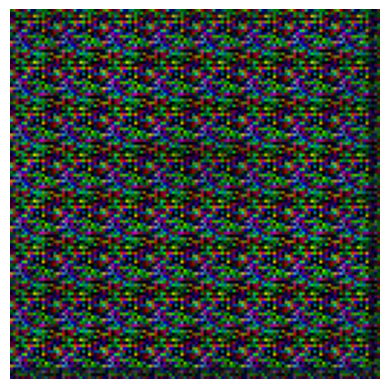

Epoch 8201 completed


Epoch 8202 completed


Epoch 8203 completed


Epoch 8204 completed


Epoch 8205 completed


Epoch 8206 completed


Epoch 8207 completed


Epoch 8208 completed


Epoch 8209 completed


Epoch 8210 completed


Epoch 8211 completed


Epoch 8212 completed


Epoch 8213 completed


Epoch 8214 completed


Epoch 8215 completed


Epoch 8216 completed


Epoch 8217 completed


Epoch 8218 completed


Epoch 8219 completed


Epoch 8220 completed


Epoch 8221 completed


Epoch 8222 completed


Epoch 8223 completed


Epoch 8224 completed


Epoch 8225 completed


Epoch 8226 completed


Epoch 8227 completed


Epoch 8228 completed


Epoch 8229 completed


Epoch 8230 completed


Epoch 8231 completed


Epoch 8232 completed


Epoch 8233 completed


Epoch 8234 completed


Epoch 8235 completed


Epoch 8236 completed


Epoch 8237 completed


Epoch 8238 completed


Epoch 8239 completed


Epoch 8240 completed


Epoch 8241 completed


Epoch 8242 completed


Epoch 8243 completed


Epoch 8244 

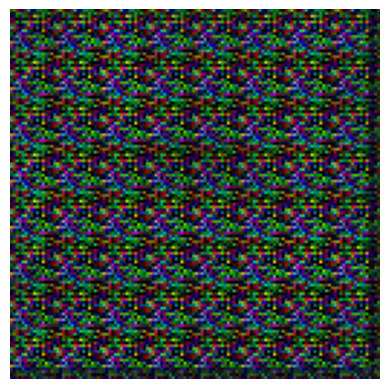

Epoch 8301 completed


Epoch 8302 completed


Epoch 8303 completed


Epoch 8304 completed


Epoch 8305 completed


Epoch 8306 completed


Epoch 8307 completed


Epoch 8308 completed


Epoch 8309 completed


Epoch 8310 completed


Epoch 8311 completed


Epoch 8312 completed


Epoch 8313 completed


Epoch 8314 completed


Epoch 8315 completed


Epoch 8316 completed


Epoch 8317 completed


Epoch 8318 completed


Epoch 8319 completed


Epoch 8320 completed


Epoch 8321 completed


Epoch 8322 completed


Epoch 8323 completed


Epoch 8324 completed


Epoch 8325 completed


Epoch 8326 completed


Epoch 8327 completed


Epoch 8328 completed


Epoch 8329 completed


Epoch 8330 completed


Epoch 8331 completed


Epoch 8332 completed


Epoch 8333 completed


Epoch 8334 completed


Epoch 8335 completed


Epoch 8336 completed


Epoch 8337 completed


Epoch 8338 completed


Epoch 8339 completed


Epoch 8340 completed


Epoch 8341 completed


Epoch 8342 completed


Epoch 8343 completed


Epoch 8344 

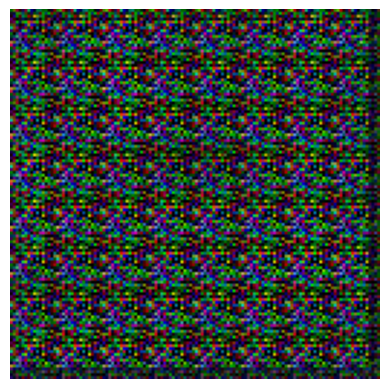

Epoch 8401 completed


Epoch 8402 completed


Epoch 8403 completed


Epoch 8404 completed


Epoch 8405 completed


Epoch 8406 completed


Epoch 8407 completed


Epoch 8408 completed


Epoch 8409 completed


Epoch 8410 completed


Epoch 8411 completed


Epoch 8412 completed


Epoch 8413 completed


Epoch 8414 completed


Epoch 8415 completed


Epoch 8416 completed


Epoch 8417 completed


Epoch 8418 completed


Epoch 8419 completed


Epoch 8420 completed


Epoch 8421 completed


Epoch 8422 completed


Epoch 8423 completed


Epoch 8424 completed


Epoch 8425 completed


Epoch 8426 completed


Epoch 8427 completed


Epoch 8428 completed


Epoch 8429 completed


Epoch 8430 completed


Epoch 8431 completed


Epoch 8432 completed


Epoch 8433 completed


Epoch 8434 completed


Epoch 8435 completed


Epoch 8436 completed


Epoch 8437 completed


Epoch 8438 completed


Epoch 8439 completed


Epoch 8440 completed


Epoch 8441 completed


Epoch 8442 completed


Epoch 8443 completed


Epoch 8444 

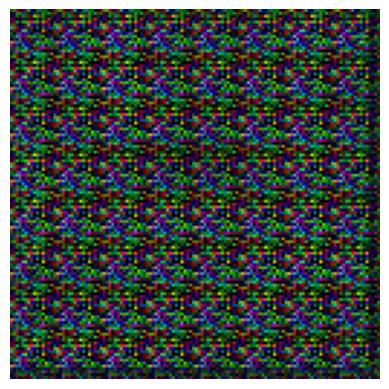

Epoch 8501 completed


Epoch 8502 completed


Epoch 8503 completed


Epoch 8504 completed


Epoch 8505 completed


Epoch 8506 completed


Epoch 8507 completed


Epoch 8508 completed


Epoch 8509 completed


Epoch 8510 completed


Epoch 8511 completed


Epoch 8512 completed


Epoch 8513 completed


Epoch 8514 completed


Epoch 8515 completed


Epoch 8516 completed


Epoch 8517 completed


Epoch 8518 completed


Epoch 8519 completed


Epoch 8520 completed


Epoch 8521 completed


Epoch 8522 completed


Epoch 8523 completed


Epoch 8524 completed


Epoch 8525 completed


Epoch 8526 completed


Epoch 8527 completed


Epoch 8528 completed


Epoch 8529 completed


Epoch 8530 completed


Epoch 8531 completed


Epoch 8532 completed


Epoch 8533 completed


Epoch 8534 completed


Epoch 8535 completed


Epoch 8536 completed


Epoch 8537 completed


Epoch 8538 completed


Epoch 8539 completed


Epoch 8540 completed


Epoch 8541 completed


Epoch 8542 completed


Epoch 8543 completed


Epoch 8544 

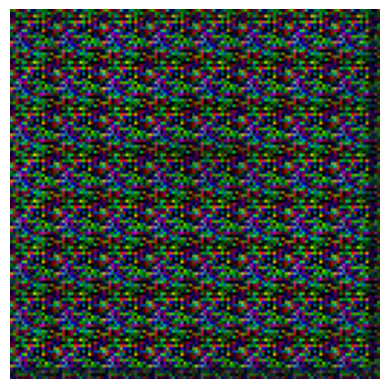

Epoch 8601 completed


Epoch 8602 completed


Epoch 8603 completed


Epoch 8604 completed


Epoch 8605 completed


Epoch 8606 completed


Epoch 8607 completed


Epoch 8608 completed


Epoch 8609 completed


Epoch 8610 completed


Epoch 8611 completed


Epoch 8612 completed


Epoch 8613 completed


Epoch 8614 completed


Epoch 8615 completed


Epoch 8616 completed


Epoch 8617 completed


Epoch 8618 completed


Epoch 8619 completed


Epoch 8620 completed


Epoch 8621 completed


Epoch 8622 completed


Epoch 8623 completed


Epoch 8624 completed


Epoch 8625 completed


Epoch 8626 completed


Epoch 8627 completed


Epoch 8628 completed


Epoch 8629 completed


Epoch 8630 completed


Epoch 8631 completed


Epoch 8632 completed


Epoch 8633 completed


Epoch 8634 completed


Epoch 8635 completed


Epoch 8636 completed


Epoch 8637 completed


Epoch 8638 completed


Epoch 8639 completed


Epoch 8640 completed


Epoch 8641 completed


Epoch 8642 completed


Epoch 8643 completed


Epoch 8644 

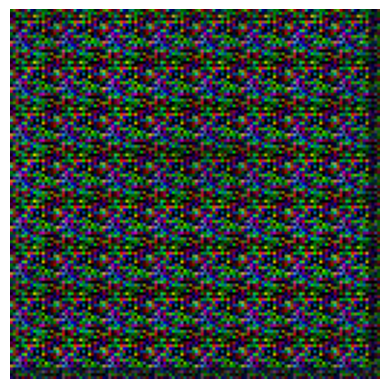

Epoch 8701 completed


Epoch 8702 completed


Epoch 8703 completed


Epoch 8704 completed


Epoch 8705 completed


Epoch 8706 completed


Epoch 8707 completed


Epoch 8708 completed


Epoch 8709 completed


Epoch 8710 completed


Epoch 8711 completed


Epoch 8712 completed


Epoch 8713 completed


Epoch 8714 completed


Epoch 8715 completed


Epoch 8716 completed


Epoch 8717 completed


Epoch 8718 completed


Epoch 8719 completed


Epoch 8720 completed


Epoch 8721 completed


Epoch 8722 completed


Epoch 8723 completed


Epoch 8724 completed


Epoch 8725 completed


Epoch 8726 completed


Epoch 8727 completed


Epoch 8728 completed


Epoch 8729 completed


Epoch 8730 completed


Epoch 8731 completed


Epoch 8732 completed


Epoch 8733 completed


Epoch 8734 completed


Epoch 8735 completed


Epoch 8736 completed


Epoch 8737 completed


Epoch 8738 completed


Epoch 8739 completed


Epoch 8740 completed


Epoch 8741 completed


Epoch 8742 completed


Epoch 8743 completed


Epoch 8744 

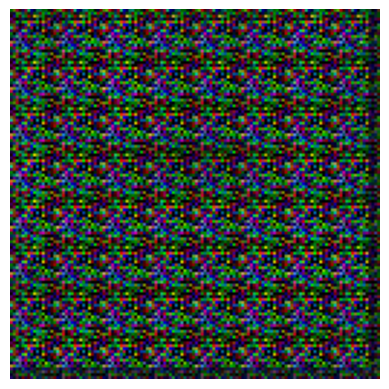

Epoch 8801 completed


Epoch 8802 completed


Epoch 8803 completed


Epoch 8804 completed


Epoch 8805 completed


Epoch 8806 completed


Epoch 8807 completed


Epoch 8808 completed


Epoch 8809 completed


Epoch 8810 completed


Epoch 8811 completed


Epoch 8812 completed


Epoch 8813 completed


Epoch 8814 completed


Epoch 8815 completed


Epoch 8816 completed


Epoch 8817 completed


Epoch 8818 completed


Epoch 8819 completed


Epoch 8820 completed


Epoch 8821 completed


Epoch 8822 completed


Epoch 8823 completed


Epoch 8824 completed


Epoch 8825 completed


Epoch 8826 completed


Epoch 8827 completed


Epoch 8828 completed


Epoch 8829 completed


Epoch 8830 completed


Epoch 8831 completed


Epoch 8832 completed


Epoch 8833 completed


Epoch 8834 completed


Epoch 8835 completed


Epoch 8836 completed


Epoch 8837 completed


Epoch 8838 completed


Epoch 8839 completed


Epoch 8840 completed


Epoch 8841 completed


Epoch 8842 completed


Epoch 8843 completed


Epoch 8844 

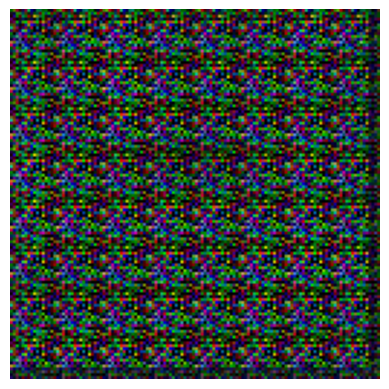

Epoch 8901 completed


Epoch 8902 completed


Epoch 8903 completed


Epoch 8904 completed


Epoch 8905 completed


Epoch 8906 completed


Epoch 8907 completed


Epoch 8908 completed


Epoch 8909 completed


Epoch 8910 completed


Epoch 8911 completed


Epoch 8912 completed


Epoch 8913 completed


Epoch 8914 completed


Epoch 8915 completed


Epoch 8916 completed


Epoch 8917 completed


Epoch 8918 completed


Epoch 8919 completed


Epoch 8920 completed


Epoch 8921 completed


Epoch 8922 completed


Epoch 8923 completed


Epoch 8924 completed


Epoch 8925 completed


Epoch 8926 completed


Epoch 8927 completed


Epoch 8928 completed


Epoch 8929 completed


Epoch 8930 completed


Epoch 8931 completed


Epoch 8932 completed


Epoch 8933 completed


Epoch 8934 completed


Epoch 8935 completed


Epoch 8936 completed


Epoch 8937 completed


Epoch 8938 completed


Epoch 8939 completed


Epoch 8940 completed


Epoch 8941 completed


Epoch 8942 completed


Epoch 8943 completed


Epoch 8944 

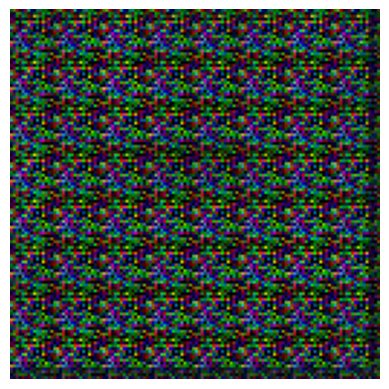

Epoch 9001 completed


Epoch 9002 completed


Epoch 9003 completed


Epoch 9004 completed


Epoch 9005 completed


Epoch 9006 completed


Epoch 9007 completed


Epoch 9008 completed


Epoch 9009 completed


Epoch 9010 completed


Epoch 9011 completed


Epoch 9012 completed


Epoch 9013 completed


Epoch 9014 completed


Epoch 9015 completed


Epoch 9016 completed


Epoch 9017 completed


Epoch 9018 completed


Epoch 9019 completed


Epoch 9020 completed


Epoch 9021 completed


Epoch 9022 completed


Epoch 9023 completed


Epoch 9024 completed


Epoch 9025 completed


Epoch 9026 completed


Epoch 9027 completed


Epoch 9028 completed


Epoch 9029 completed


Epoch 9030 completed


Epoch 9031 completed


Epoch 9032 completed


Epoch 9033 completed


Epoch 9034 completed


Epoch 9035 completed


Epoch 9036 completed


Epoch 9037 completed


Epoch 9038 completed


Epoch 9039 completed


Epoch 9040 completed


Epoch 9041 completed


Epoch 9042 completed


Epoch 9043 completed


Epoch 9044 

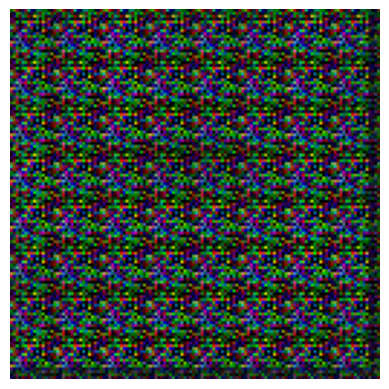

Epoch 9101 completed


Epoch 9102 completed


Epoch 9103 completed


Epoch 9104 completed


Epoch 9105 completed


Epoch 9106 completed


Epoch 9107 completed


Epoch 9108 completed


Epoch 9109 completed


Epoch 9110 completed


Epoch 9111 completed


Epoch 9112 completed


Epoch 9113 completed


Epoch 9114 completed


Epoch 9115 completed


Epoch 9116 completed


Epoch 9117 completed


Epoch 9118 completed


Epoch 9119 completed


Epoch 9120 completed


Epoch 9121 completed


Epoch 9122 completed


Epoch 9123 completed


Epoch 9124 completed


Epoch 9125 completed


Epoch 9126 completed


Epoch 9127 completed


Epoch 9128 completed


Epoch 9129 completed


Epoch 9130 completed


Epoch 9131 completed


Epoch 9132 completed


Epoch 9133 completed


Epoch 9134 completed


Epoch 9135 completed


Epoch 9136 completed


Epoch 9137 completed


Epoch 9138 completed


Epoch 9139 completed


Epoch 9140 completed


Epoch 9141 completed


Epoch 9142 completed


Epoch 9143 completed


Epoch 9144 

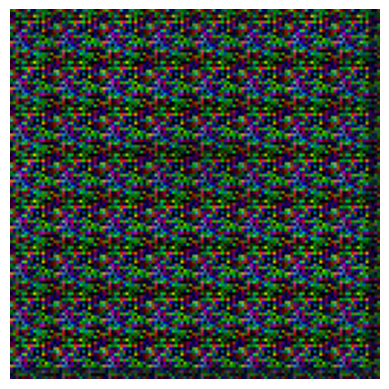

Epoch 9201 completed


Epoch 9202 completed


Epoch 9203 completed


Epoch 9204 completed


Epoch 9205 completed


Epoch 9206 completed


Epoch 9207 completed


Epoch 9208 completed


Epoch 9209 completed


Epoch 9210 completed


Epoch 9211 completed


Epoch 9212 completed


Epoch 9213 completed


Epoch 9214 completed


Epoch 9215 completed


Epoch 9216 completed


Epoch 9217 completed


Epoch 9218 completed


Epoch 9219 completed


Epoch 9220 completed


Epoch 9221 completed


Epoch 9222 completed


Epoch 9223 completed


Epoch 9224 completed


Epoch 9225 completed


Epoch 9226 completed


Epoch 9227 completed


Epoch 9228 completed


Epoch 9229 completed


Epoch 9230 completed


Epoch 9231 completed


Epoch 9232 completed


Epoch 9233 completed


Epoch 9234 completed


Epoch 9235 completed


Epoch 9236 completed


Epoch 9237 completed


Epoch 9238 completed


Epoch 9239 completed


Epoch 9240 completed


Epoch 9241 completed


Epoch 9242 completed


Epoch 9243 completed


Epoch 9244 

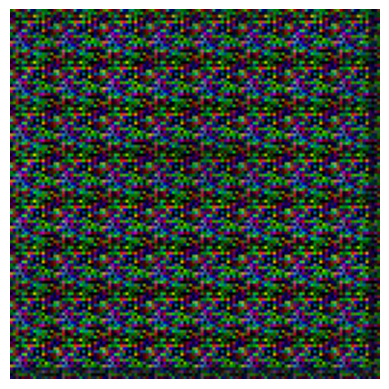

Epoch 9301 completed


Epoch 9302 completed


Epoch 9303 completed


Epoch 9304 completed


Epoch 9305 completed


Epoch 9306 completed


Epoch 9307 completed


Epoch 9308 completed


Epoch 9309 completed


Epoch 9310 completed


Epoch 9311 completed


Epoch 9312 completed


Epoch 9313 completed


Epoch 9314 completed


Epoch 9315 completed


Epoch 9316 completed


Epoch 9317 completed


Epoch 9318 completed


Epoch 9319 completed


Epoch 9320 completed


Epoch 9321 completed


Epoch 9322 completed


Epoch 9323 completed


Epoch 9324 completed


Epoch 9325 completed


Epoch 9326 completed


Epoch 9327 completed


Epoch 9328 completed


Epoch 9329 completed


Epoch 9330 completed


Epoch 9331 completed


Epoch 9332 completed


Epoch 9333 completed


Epoch 9334 completed


Epoch 9335 completed


Epoch 9336 completed


Epoch 9337 completed


Epoch 9338 completed


Epoch 9339 completed


Epoch 9340 completed


Epoch 9341 completed


Epoch 9342 completed


Epoch 9343 completed


Epoch 9344 

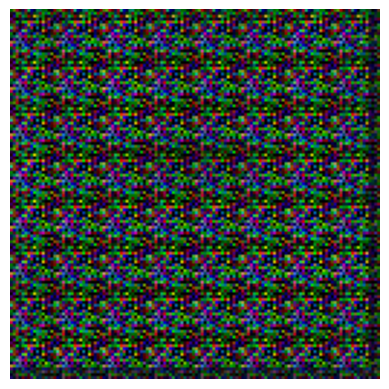

Epoch 9401 completed


Epoch 9402 completed


Epoch 9403 completed


Epoch 9404 completed


Epoch 9405 completed


Epoch 9406 completed


Epoch 9407 completed


Epoch 9408 completed


Epoch 9409 completed


Epoch 9410 completed


Epoch 9411 completed


Epoch 9412 completed


Epoch 9413 completed


Epoch 9414 completed


Epoch 9415 completed


Epoch 9416 completed


Epoch 9417 completed


Epoch 9418 completed


Epoch 9419 completed


Epoch 9420 completed


Epoch 9421 completed


Epoch 9422 completed


Epoch 9423 completed


Epoch 9424 completed


Epoch 9425 completed


Epoch 9426 completed


Epoch 9427 completed


Epoch 9428 completed


Epoch 9429 completed


Epoch 9430 completed


Epoch 9431 completed


Epoch 9432 completed


Epoch 9433 completed


Epoch 9434 completed


Epoch 9435 completed


Epoch 9436 completed


Epoch 9437 completed


Epoch 9438 completed


Epoch 9439 completed


Epoch 9440 completed


Epoch 9441 completed


Epoch 9442 completed


Epoch 9443 completed


Epoch 9444 

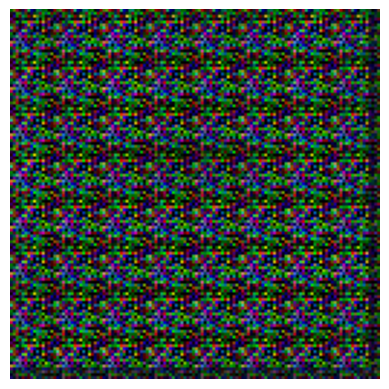

Epoch 9501 completed


Epoch 9502 completed


Epoch 9503 completed


Epoch 9504 completed


Epoch 9505 completed


Epoch 9506 completed


Epoch 9507 completed


Epoch 9508 completed


Epoch 9509 completed


Epoch 9510 completed


Epoch 9511 completed


Epoch 9512 completed


Epoch 9513 completed


Epoch 9514 completed


Epoch 9515 completed


Epoch 9516 completed


Epoch 9517 completed


Epoch 9518 completed


Epoch 9519 completed


Epoch 9520 completed


Epoch 9521 completed


Epoch 9522 completed


Epoch 9523 completed


Epoch 9524 completed


Epoch 9525 completed


Epoch 9526 completed


Epoch 9527 completed


Epoch 9528 completed


Epoch 9529 completed


Epoch 9530 completed


Epoch 9531 completed


Epoch 9532 completed


Epoch 9533 completed


Epoch 9534 completed


Epoch 9535 completed


Epoch 9536 completed


Epoch 9537 completed


Epoch 9538 completed


Epoch 9539 completed


Epoch 9540 completed


Epoch 9541 completed


Epoch 9542 completed


Epoch 9543 completed


Epoch 9544 

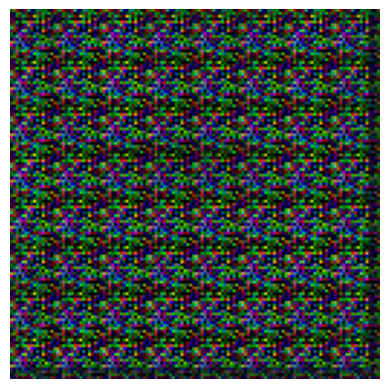

Epoch 9601 completed


Epoch 9602 completed


Epoch 9603 completed


Epoch 9604 completed


Epoch 9605 completed


Epoch 9606 completed


Epoch 9607 completed


Epoch 9608 completed


Epoch 9609 completed


Epoch 9610 completed


Epoch 9611 completed


Epoch 9612 completed


Epoch 9613 completed


Epoch 9614 completed


Epoch 9615 completed


Epoch 9616 completed


Epoch 9617 completed


Epoch 9618 completed


Epoch 9619 completed


Epoch 9620 completed


Epoch 9621 completed


Epoch 9622 completed


Epoch 9623 completed


Epoch 9624 completed


Epoch 9625 completed


Epoch 9626 completed


Epoch 9627 completed


Epoch 9628 completed


Epoch 9629 completed


Epoch 9630 completed


Epoch 9631 completed


Epoch 9632 completed


Epoch 9633 completed


Epoch 9634 completed


Epoch 9635 completed


Epoch 9636 completed


Epoch 9637 completed


Epoch 9638 completed


Epoch 9639 completed


Epoch 9640 completed


Epoch 9641 completed


Epoch 9642 completed


Epoch 9643 completed


Epoch 9644 

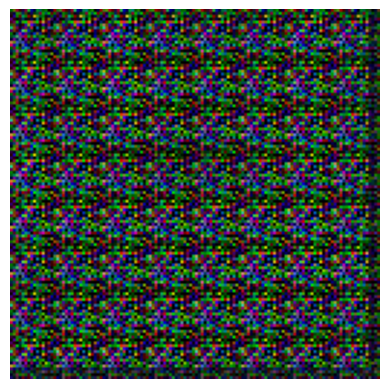

Epoch 9701 completed


Epoch 9702 completed


Epoch 9703 completed


Epoch 9704 completed


Epoch 9705 completed


Epoch 9706 completed


Epoch 9707 completed


Epoch 9708 completed


Epoch 9709 completed


Epoch 9710 completed


Epoch 9711 completed


Epoch 9712 completed


Epoch 9713 completed


Epoch 9714 completed


Epoch 9715 completed


Epoch 9716 completed


Epoch 9717 completed


Epoch 9718 completed


Epoch 9719 completed


Epoch 9720 completed


Epoch 9721 completed


Epoch 9722 completed


Epoch 9723 completed


Epoch 9724 completed


Epoch 9725 completed


Epoch 9726 completed


Epoch 9727 completed


Epoch 9728 completed


Epoch 9729 completed


Epoch 9730 completed


Epoch 9731 completed


Epoch 9732 completed


Epoch 9733 completed


Epoch 9734 completed


Epoch 9735 completed


Epoch 9736 completed


Epoch 9737 completed


Epoch 9738 completed


Epoch 9739 completed


Epoch 9740 completed


Epoch 9741 completed


Epoch 9742 completed


Epoch 9743 completed


Epoch 9744 

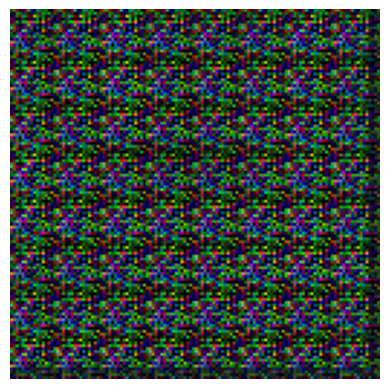

Epoch 9801 completed


Epoch 9802 completed


Epoch 9803 completed


Epoch 9804 completed


Epoch 9805 completed


Epoch 9806 completed


Epoch 9807 completed


Epoch 9808 completed


Epoch 9809 completed


Epoch 9810 completed


Epoch 9811 completed


Epoch 9812 completed


Epoch 9813 completed


Epoch 9814 completed


Epoch 9815 completed


Epoch 9816 completed


Epoch 9817 completed


Epoch 9818 completed


Epoch 9819 completed


Epoch 9820 completed


Epoch 9821 completed


Epoch 9822 completed


Epoch 9823 completed


Epoch 9824 completed


Epoch 9825 completed


Epoch 9826 completed


Epoch 9827 completed


Epoch 9828 completed


Epoch 9829 completed


Epoch 9830 completed


Epoch 9831 completed


Epoch 9832 completed


Epoch 9833 completed


Epoch 9834 completed


Epoch 9835 completed


Epoch 9836 completed


Epoch 9837 completed


Epoch 9838 completed


Epoch 9839 completed


Epoch 9840 completed


Epoch 9841 completed


Epoch 9842 completed


Epoch 9843 completed


Epoch 9844 

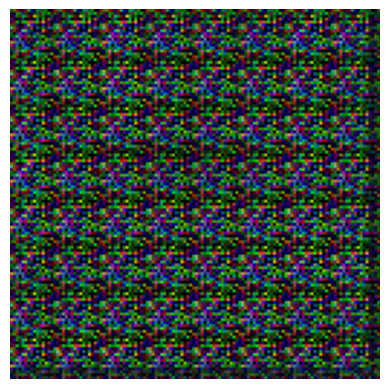

Epoch 9901 completed


Epoch 9902 completed


Epoch 9903 completed


Epoch 9904 completed


Epoch 9905 completed


Epoch 9906 completed


Epoch 9907 completed


Epoch 9908 completed


Epoch 9909 completed


Epoch 9910 completed


Epoch 9911 completed


Epoch 9912 completed


Epoch 9913 completed


Epoch 9914 completed


Epoch 9915 completed


Epoch 9916 completed


Epoch 9917 completed


Epoch 9918 completed


Epoch 9919 completed


Epoch 9920 completed


Epoch 9921 completed


Epoch 9922 completed


Epoch 9923 completed


Epoch 9924 completed


Epoch 9925 completed


Epoch 9926 completed


Epoch 9927 completed


Epoch 9928 completed


Epoch 9929 completed


Epoch 9930 completed


Epoch 9931 completed


Epoch 9932 completed


Epoch 9933 completed


Epoch 9934 completed


Epoch 9935 completed


Epoch 9936 completed


Epoch 9937 completed


Epoch 9938 completed


Epoch 9939 completed


Epoch 9940 completed


Epoch 9941 completed


Epoch 9942 completed


Epoch 9943 completed


Epoch 9944 

In [14]:
gan.train(images, 10000)

In [16]:
gan.generator.save("model/generator.keras")

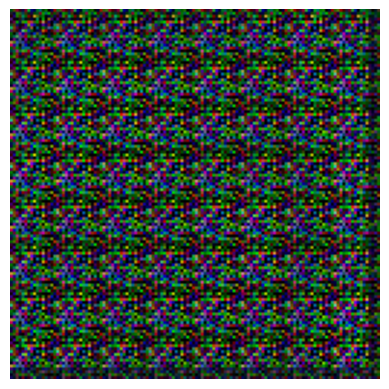

In [17]:
test_noise = np.random.normal(0, 1, (1, gan.LATENT_DIMS))
gan.show_generated_image(test_noise)